## Final Project Submission

Please fill out:
* Student name: **PHINIDY GEORGE**
* Student pace: full time
* Scheduled project review date/time: 
* Instructor name: **ASHA DEEN**
* Blog post URL:


**0. Library importation**

In [452]:
from crash_data_utils import summary

import pandas as pd
import numpy as np
import os
import matplotlib.pyplot as plt
import seaborn as sns
from IPython.display import display
import calendar
import numpy as np
np.float = float

# Define the path to your dataset
file_path = r'C:\Users\user\Data_Science_Course\chicago_2019_2022.csv'

# Load the dataset with low_memory=False
df = pd.read_csv(file_path, low_memory=False)

import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from sklearn.model_selection import StratifiedKFold, train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.metrics import recall_score, precision_score, accuracy_score, roc_auc_score, confusion_matrix, classification_report
from imblearn.over_sampling import SMOTE
from imblearn.pipeline import Pipeline as ImbPipeline
import matplotlib.pyplot as plt

from sklearn.model_selection import train_test_split, StratifiedKFold, cross_val_score, GridSearchCV
from sklearn.preprocessing import OneHotEncoder, StandardScaler, LabelEncoder
from sklearn.metrics import classification_report, confusion_matrix, roc_curve, auc, ConfusionMatrixDisplay
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
import matplotlib.pyplot as plt

import folium
from folium.plugins import HeatMap
import folium
from folium.plugins import MarkerCluster


In [453]:
#This class reviews my dataset
class DataReview:
    def __init__(self, file_path):
        self.df = pd.read_csv(file_path, low_memory=False)

    def display_head(self):
        display(self.df.head())
        
    def display_shape(self):
        display(self.df.shape)
        
    def display_info(self):
        display(self.df.info())
        
    def plot_data_types(self):
        column_types = self.df.dtypes.value_counts().reset_index()
        column_types.columns = ['Data Type', 'Count']
        column_types['Data Type'] = column_types['Data Type'].astype(str)
        total_count = column_types['Count'].sum()
        
        plt.figure(figsize=(10, 6))
        ax = sns.barplot(x='Data Type', y='Count', data=column_types)
        plt.xlabel('Data Types')
        plt.ylabel('Count')
        plt.title('Count of Columns by Data Type')
        
        for p in ax.patches:
            height = p.get_height()
            ax.annotate(f'{height/total_count*100:.2f}%', (p.get_x() + p.get_width() / 2., height),
                        ha='center', va='bottom', fontsize=12, color='black')
        
        plt.show()
        
    def display_missing_info(self):
        total_rows = len(self.df)
        missing_data = self.df.isnull().sum()
        missing_percentage = (missing_data / total_rows) * 100
        
        missing_info = pd.DataFrame({
            'Column Name': missing_data.index,
            'Missing Values': missing_data.values,
            'Missing Percentage (%)': missing_percentage.values
        })
        
        missing_info = missing_info.sort_values(by='Missing Percentage (%)', ascending=False)
        missing_info.to_excel('missing_values_for_dataframe.xlsx', index=False)
        display(missing_info)
        
    def display_summary_statistics(self):
        summary_stats = self.df.describe(include='all', datetime_is_numeric=True).T.iloc[:20]
        display(summary_stats)

    def display_column_names(self):
        column_names = self.df.columns.tolist()
        print(column_names)
        display(column_names)

    def display_unique_counts(self):
        print('Unique country count:', self.df['country'].nunique())
        print('Unique city count:', self.df['city'].nunique())
        print('Unique state count:', self.df['state'].nunique())
    
    def process_and_display_df_1(self):
        total_first = len(self.df.columns.tolist())
        print('Total columns:', total_first, '\n')
        print(self.df.columns.tolist())

        print('Unique country count:', self.df['country'].nunique())
        print('Unique city count:', self.df['city'].nunique())
        print('Unique state count:', self.df['state'].nunique())
        
        df_1 = self.df[self.df['state'] == 'illinois'].copy()
        df_1 = df_1.drop(columns=['country', 'city', 'state', 'id', 'windgust', 'winddir', 
                                  'moonphase', 'sunset', 'sunrise', 'lattitude', 'longitude', 
                                  'days_tempmin', 'pressure', 'precip_type', 'days_tempmin', 
                                  'days_tempmax', 'days_temp', 'days_feelslikemin', 
                                  'days_feelslikemax', 'days_feelslike', 'days_dew', 
                                  'days_humidity', 'days_precip', 'days_precipprob', 
                                  'days_precipcover', 'days_preciptype', 'days_snow', 
                                  'days_snowdepth', 'days_windgust', 'days_windspeed', 
                                  'days_winddir', 'days_pressure', 'days_cloudcover', 
                                  'days_visibility', 'days_uvindex', 'days_conditions', 
                                  'days_moonphase', 'feelslike', 'injury_non_incapacitated', 
                                  'snow', 'dew', 'precipprob'])

        column_names = df_1.columns.tolist()
        print('Total columns:', len(column_names), 'out of', total_first, '\n')
        display(df_1.head())

file_path = r'C:\Users\user\Data_Science_Course\chicago_2019_2022.csv'
data_review = DataReview(file_path)




# Make a copy of df_1 and call it df_2
data_review.process_and_display_df_1()
df_2 = data_review.df[data_review.df['state'] == 'illinois'].copy()
df_2 = df_2.drop(columns=['country', 'city', 'state', 'id', 'windgust', 'winddir', 
                           'moonphase', 'sunset', 'sunrise', 'lattitude', 'longitude', 
                           'days_tempmin', 'pressure', 'precip_type', 'days_tempmin', 
                           'days_tempmax', 'days_temp', 'days_feelslikemin', 
                           'days_feelslikemax', 'days_feelslike', 'days_dew', 
                           'days_humidity', 'days_precip', 'days_precipprob', 
                           'days_precipcover', 'days_preciptype', 'days_snow', 
                           'days_snowdepth', 'days_windgust', 'days_windspeed', 
                           'days_winddir', 'days_pressure', 'days_cloudcover', 
                           'days_visibility', 'days_uvindex', 'days_conditions', 
                           'days_moonphase', 'feelslike', 'injury_non_incapacitated', 
                           'snow', 'dew', 'precipprob'])



Total columns: 65 

['id', 'crash_date', 'crash_time', 'town', 'city', 'state', 'country', 'total_injured', 'total_killed', 'injury_incapacitated', 'injury_non_incapacitated', 'most_severe_injury', 'crash_type', 'contributory_cause', 'sec_contributory_cause', 'num_vehicles_in_crash', 'crash_hit_and_run', 'crash_severity', 'traffic_control_device', 'traffic_control_device_condition', 'road_defect', 'lattitude', 'longitude', 'days_tempmax', 'days_tempmin', 'days_temp', 'days_feelslikemax', 'days_feelslikemin', 'days_feelslike', 'days_dew', 'days_humidity', 'days_precip', 'days_precipprob', 'days_precipcover', 'days_preciptype', 'days_snow', 'days_snowdepth', 'days_windgust', 'days_windspeed', 'days_winddir', 'days_pressure', 'days_cloudcover', 'days_visibility', 'days_uvindex', 'days_conditions', 'days_moonphase', 'temp', 'feelslike', 'humidity', 'dew', 'precip', 'precipprob', 'snow', 'snowdepth', 'precip_type', 'windgust', 'windspeed', 'winddir', 'pressure', 'visibility', 'cloudcover', 

,crash_date,crash_time,town,total_injured,total_killed,injury_incapacitated,most_severe_injury,crash_type,contributory_cause,sec_contributory_cause,...,traffic_control_device_condition,road_defect,temp,humidity,precip,snowdepth,windspeed,visibility,cloudcover,conditions
0,07/18/19,10:35,harwood heights,0,0,0,no indication of injury,rear end,weather,unable to determine,...,no controls,no defects,72.6,92.9,0.354,0,6.9,1.8,54.6,"Rain, Partially cloudy"
1,07/21/19,13:45,englewood,0,0,0,no indication of injury,rear end,unable to determine,not applicable,...,no controls,unknown,72.3,95.0,0.199,0,11.4,7.4,87.4,"Rain, Partially cloudy"
2,07/21/19,16:00,cragin,0,0,0,no indication of injury,sideswipe same direction,improper overtaking/passing,improper turning/no signal,...,functioning properly,no defects,74.6,71.6,0.029,0,13.7,9.9,58.2,"Rain, Partially cloudy"
3,07/21/19,16:45,cragin,0,0,0,no indication of injury,turning,unable to determine,not applicable,...,functioning properly,no defects,74.5,72.2,0.030,0,13.7,9.9,58.3,"Rain, Partially cloudy"
4,07/21/19,23:05,cicero,0,0,0,no indication of injury,turning,unable to determine,not applicable,...,functioning properly,unknown,66.5,59.4,0.000,0,4.9,9.9,0.0,Clear


In [454]:
#this class does the data cleaning and quality of my dataset
class DataQualityChecker:
    def __init__(self, df):
        """
        Initialize the DataQualityChecker with a DataFrame.
        """
        self.df = df

    def check_data_types(self):
        """
        Print the data types of each column in the DataFrame.
        """
        print(self.df.dtypes)

    def check_missing_values(self):
        """
        Check and print the number of missing values for each column in the DataFrame.
        """
        df_2 = self.df.copy()  # Create a copy of the DataFrame to avoid modifying the original
        missing_values_count = df_2.isnull().sum()  # Count missing values
        # Print missing values count without truncating the output
        with pd.option_context('display.max_rows', None, 'display.max_columns', None):
            print(missing_values_count)

    def check_occurrences_of_N(self):
        """
        Check and print the number of occurrences of the string '\\N' in each column.
        """
        df_2 = self.df.copy()  # Create a copy of the DataFrame to avoid modifying the original
        count_occurrences = df_2.apply(lambda x: (x == '\\N').sum())  # Count occurrences of '\\N'
        # Print count of '\\N' occurrences without truncating the output
        with pd.option_context('display.max_rows', None, 'display.max_columns', None):
            print(count_occurrences)

    def replace_missing_values(self):
        """
        Replace occurrences of '\\N' with appropriate default values in specific columns.
        """
        df_2 = self.df.copy()  # Create a copy of the DataFrame to avoid modifying the original
        # Replace '\\N' with default values in specified columns
        df_2['total_injured'] = df_2['total_injured'].replace('\\N', '-1')
        df_2['injury_incapacitated'] = df_2['total_killed'].replace('\\N', '-1')
        df_2['total_killed'] = df_2['total_killed'].replace('\\N', '-1')
        df_2['most_severe_injury'] = df_2['most_severe_injury'].replace('\\N', 'unknown')
        df_2['crash_hit_and_run'] = df_2['crash_hit_and_run'].replace('\\N', 'unknown')
        self.df = df_2  # Update the main DataFrame with the changes

    def print_unique_values(self):
        """
        Print the unique values in the 'crash_hit_and_run', 'total_injured', 'total_killed', and 'most_severe_injury' columns.
        """
        df_2 = self.df.copy()  # Create a copy of the DataFrame to avoid modifying the original
        # Print unique values for specified columns
        print(df_2['crash_hit_and_run'].unique())
        print(df_2['total_injured'].unique())
        print(df_2['total_killed'].unique())
        print(df_2['most_severe_injury'].unique())

    def replace_crash_hit_and_run_values(self):
        """
        Replace 'Y' and 'y' with 'yes' and 'N' and 'n' with 'no' in the 'crash_hit_and_run' column.
        """
        df_2 = self.df.copy()  # Create a copy of the DataFrame to avoid modifying the original
        # Replace 'Y', 'y' with 'yes' and 'N', 'n' with 'no'
        df_2['crash_hit_and_run'] = df_2['crash_hit_and_run'].replace({'Y': 'yes', 'y': 'yes', 'N': 'no', 'n': 'no'})
        print(df_2['crash_hit_and_run'].unique())  # Print unique values after replacement
        self.df = df_2  # Update the main DataFrame with the changes

    def convert_data_types(self):
        """
        Convert the data types of specific columns to appropriate types.
        """
        df_3 = self.df.copy()  # Create a copy of the DataFrame to avoid modifying the original
        # Convert columns to appropriate data types
        df_3['total_injured'] = pd.to_numeric(df_3['total_injured'], errors='coerce')
        df_3['total_killed'] = pd.to_numeric(df_3['total_killed'], errors='coerce')
        df_3['injury_incapacitated'] = pd.to_numeric(df_3['injury_incapacitated'], errors='coerce')
        df_3['crash_hit_and_run'] = df_3['crash_hit_and_run'].astype('category')
        df_3['crash_severity'] = df_3['crash_severity'].astype('category')
        df_3['snowdepth'] = pd.to_numeric(df_3['snowdepth'], errors='coerce')
        df_3['conditions'] = df_3['conditions'].astype('category')
        print(df_3.dtypes)  # Print the data types of the columns after conversion
        return df_3

    def save_to_csv(self, file_path):
        """
        Save the DataFrame to a CSV file at the specified file path.
        """
        self.df.to_csv(file_path, index=False)  # Save the DataFrame to a CSV file without the index

    def column_info_analysis(self):
        """
        Analyze and print information about each column in the DataFrame.
        """
        data = self.df.copy()
        column_info = []
        for column in data.columns:
            unique_values = data[column].unique()
            num_unique_values = len(unique_values)
            data_type = data[column].dtype
            column_info.append([column, data_type, num_unique_values, unique_values])
        column_table = pd.DataFrame(column_info, columns=['Column Name', 'Data Type', 'Number of Unique Values', 'Unique Values'])
        print(column_table)

    def describe_data(self):
        """
        Print the shape and descriptive statistics of the DataFrame.
        """
        data = self.df.copy()
        print(data.shape)
        print(data.describe())

    def visualize_correlation(self):
        """
        Visualize the correlation matrix of numerical columns in the DataFrame.
        """
        data = self.df.copy()
        numerical_columns = data.select_dtypes(include=['float64', 'int64'])
        correlation_matrix = numerical_columns.corr()
        
        # Ensure seaborn is properly imported and used for plotting
        plt.figure(figsize=(10, 8))
        sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f", linewidths=.5)
        plt.title('Correlation Matrix of Numerical Data')
        plt.show()

checker = DataQualityChecker(df_2)


**CHICAGO, IL: CAR CRASH SEVERITY ANALYSIS AND PREDICTIVE MODELLING**

Using Machine Learning to Predict Car Crash Severity

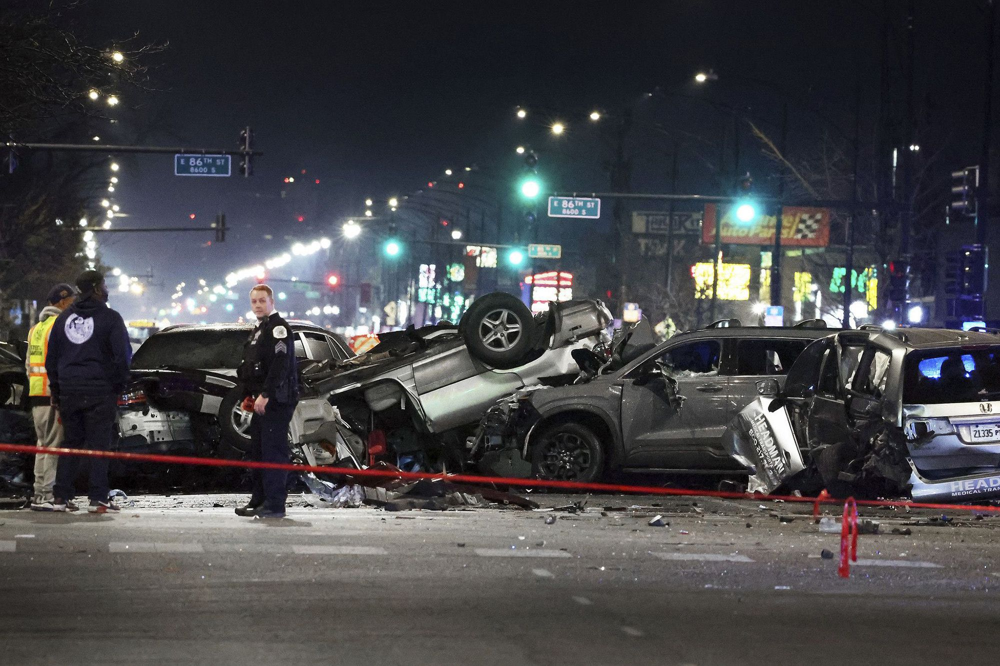

**Stakeholder: Chicago Department of Transportation**


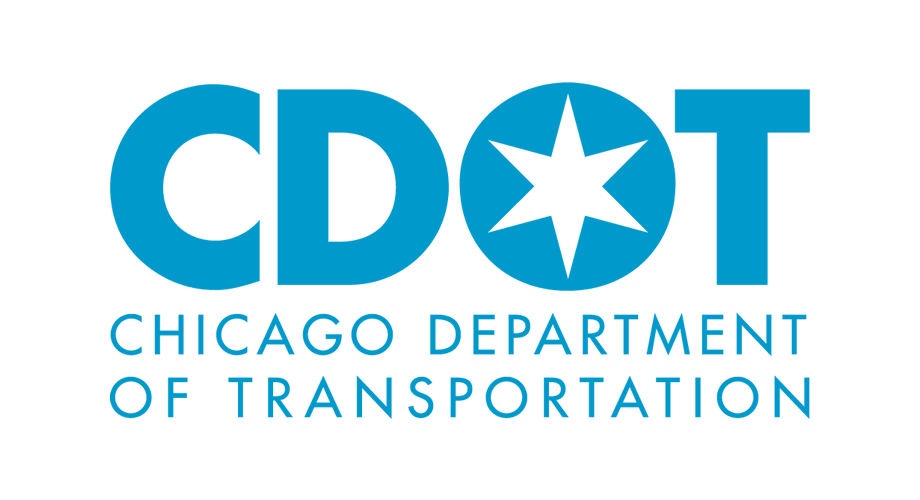

**1.BUSINESS  CASE**

Recently, a report from the National Security Council highlighted some alarming statistics from 2020.The first paragraph stated:

                 For the first time since 2007, preliminary data from the National Safety Council show that as many as 
                 42,060 people are estimated to have died in motor vehicle crashes in 2020.
                 That marks an 8% increase over 2019 in a year where people drove significantly less frequently because 
                 of the pandemic.
                                                                     
According to their data, the US hasn't experienced an increase like this since **1924**.

Following this trend, the **Governor's Highway Safety Association** highlighted that pedestrian fatalities have reached a **30-year high**. Nighttime pedestrian deaths surged by 67%, while daytime fatalities increased by 16%, emphasizing the urgent need for safer road crossings and better visibility for both pedestrians and drivers.

Zooming in on **Illinois**, approximately **1000 people** lost their lives in motor vehicle accidents in **2019** alone.

The **Advocates for Highway and Auto Safety** have evaluated all US states based on their Roadmap for State Highway Safety Laws, which includes 16 laws focused on occupant protection (e.g., seat belt and helmet laws), child protection, and teen driving.
"""

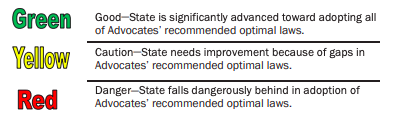

When Illinois is scored against this Roadmap, it has been given a yellow rating (Caution), since it still lacks the following safety laws:

- All-Rider Motorcycle Helmet Law
- Booster Seat Law
- GDL (Graduated Driver's License) – Minimum Age 16 for Learner’s Permit
- GDL – Stronger Nighttime Restriction Provision
- GDL – Stronger Passenger Restriction Provision
- GDL – Age 18 for Unrestricted License                       
                        
In response, the Chicago Department of Transportation is actively working with Vision Zero, an initiative aimed at reducing road accidents. Vision Zero's report and action plan utilize crash data to identify high-risk corridors in the city and guide efforts in education, road safety improvements, and more.

**1.1 PROJECT OBJECTIVE**

Considering these ongoing safety efforts and road safety issues, our analysis and modeling of this data will be guided by the goal of enhancing road safety. Specifically, our focus will be on predicting the severity of crashes based on injury outcomes.

**2.DATA UNDERSTANDING**

**Data: Chicago City Data Portal**


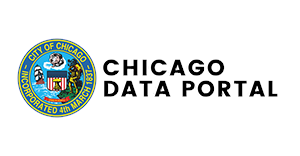

Our Chicago Traffic dataset came from the City of Chicago Data portal.It had:

**Number of Rows: 372,062**

**Number of columns:  65**

In [455]:
summary.head(65)

,Column Name,Description
0,id,Unique identifier for each crash record.
1,crash_date,Date of the crash.
2,crash_time,Time of the crash.
3,town,Town where the crash occurred.
4,city,City where the crash occurred.
...,...,...
60,cloudcover,Cloud cover at the time of the crash.
61,conditions,Weather conditions at the time of the crash.
62,sunrise,Time of sunrise on the day of the crash.
63,sunset,Time of sunset on the day of the crash.


 **Overeview Of Dataset Columns**

The dataset's columns provide a comprehensive view of various factors influencing motor vehicle crashes, from temporal and spatial dimensions to environmental and infrastructural conditions. This allows for a multi-faceted analysis, helping identify key risk factors and high-risk areas, which are essential for developing effective safety interventions and policies.

**3.DATA PROCESSING**

**Step 1: Data Review**

- Review the existing crash dataset thoroughly to identify any issues, ambiguities, inconsistencies, or areas for improvement. This involves examining the structure, content, and quality of the data.

In [456]:
data_review.display_shape()

(372062, 65)

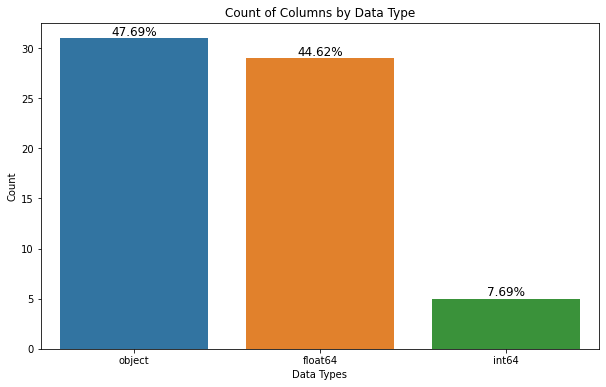

In [457]:
data_review.plot_data_types()

In [458]:
data_review.display_missing_info()

,Column Name,Missing Values,Missing Percentage (%)
0,id,0,0.0
33,days_precipcover,0,0.0
35,days_snow,0,0.0
36,days_snowdepth,0,0.0
37,days_windgust,0,0.0
...,...,...,...
27,days_feelslikemin,0,0.0
28,days_feelslike,0,0.0
29,days_dew,0,0.0
30,days_humidity,0,0.0


In [459]:
data_review.display_summary_statistics()

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
id,372062,NaN,NaN,NaN,2.00442e+08,107406,2.00256e+08,2.00349e+08,2.00442e+08,2.00535e+08,2.00628e+08
crash_date,372062,1294,01/12/19,582,NaN,NaN,NaN,NaN,NaN,NaN,NaN
crash_time,372062,1440,16:00,5303,NaN,NaN,NaN,NaN,NaN,NaN,NaN
town,372062,71,mccormickville,54877,NaN,NaN,NaN,NaN,NaN,NaN,NaN
city,372062,1,chicago,372062,NaN,NaN,NaN,NaN,NaN,NaN,NaN
state,372062,3,illinois,371997,NaN,NaN,NaN,NaN,NaN,NaN,NaN
country,372062,1,usa,372062,NaN,NaN,NaN,NaN,NaN,NaN,NaN
total_injured,372062,19,0,316611,NaN,NaN,NaN,NaN,NaN,NaN,NaN
total_killed,372062,5,0,370728,NaN,NaN,NaN,NaN,NaN,NaN,NaN
injury_incapacitated,372062,8,0,364268,NaN,NaN,NaN,NaN,NaN,NaN,NaN


**Step 2: Continuous Improvement**

- Based on my review, provide feedback and suggestions to improve the dataset's quality and usability. Consider the following aspects:
  - Data Cleaning: Identify and address missing values, duplicate records, and outliers.
  - Standardization: Ensure consistent formatting of data fields (e.g., date, time, location).
  - Data Validation: Check for data integrity and accuracy.
  - Data Enrichment: If possible, add additional relevant data fields that could enhance the dataset's value.
  - Data Normalization: Normalize data values where necessary (e.g., converting units, standardizing categorical values).
  - Quality Assurance: Implement data quality checks and validation rules.

### Columns to Remove:
**1. id** - arbitrary identifier.

**2. country** - always should display USA.

**3. city** - always should display Chicago.

**4. state** - always should display Illinois.

**5. windgust** - this column has many missing values and we can use windspeed column to correlate wind condition with car crashes. We can also remove winddir and use wind speed to correlate wind conditions with a crash.

**6. winddir** - use windspeed to correlate wind conditions with a crash.

**7. moonphase** - sunrise and sunset times are not particularly important in this scenario.

**8. sunrise** - sunrise and sunset times are not particularly important in this scenario.

**9. sunset** - sunrise and sunset times are not particularly important in this scenario.

**10. lattitude** - representing exact locations, are not relevant to our analysis.

**11. longitude** - representing exact locations, are not relevant to our analysis.

**12. feelslike** - "feels-like" temperature on a given day is irrelevant to our analysis.

**13. injury_non_incapacitated** - we can use total_injured and injury_incapacitated columns to measure severity of a crash.

**14. snow** - snowdepth makes this column arbitrary.

**15. dew** - humidity and precipitation columns already give us good idea about weather conditions.

**16. precipprob** - humidity and precipitation columns already give us good idea about weather conditions.

**17. pressure** - not relevant to our analysis.

**18. precip_type** - conditions columns already gives us detailed review of weather condition.


In [460]:
data_review.display_column_names()


['id', 'crash_date', 'crash_time', 'town', 'city', 'state', 'country', 'total_injured', 'total_killed', 'injury_incapacitated', 'injury_non_incapacitated', 'most_severe_injury', 'crash_type', 'contributory_cause', 'sec_contributory_cause', 'num_vehicles_in_crash', 'crash_hit_and_run', 'crash_severity', 'traffic_control_device', 'traffic_control_device_condition', 'road_defect', 'lattitude', 'longitude', 'days_tempmax', 'days_tempmin', 'days_temp', 'days_feelslikemax', 'days_feelslikemin', 'days_feelslike', 'days_dew', 'days_humidity', 'days_precip', 'days_precipprob', 'days_precipcover', 'days_preciptype', 'days_snow', 'days_snowdepth', 'days_windgust', 'days_windspeed', 'days_winddir', 'days_pressure', 'days_cloudcover', 'days_visibility', 'days_uvindex', 'days_conditions', 'days_moonphase', 'temp', 'feelslike', 'humidity', 'dew', 'precip', 'precipprob', 'snow', 'snowdepth', 'precip_type', 'windgust', 'windspeed', 'winddir', 'pressure', 'visibility', 'cloudcover', 'conditions', 'sunri

['id',
 'crash_date',
 'crash_time',
 'town',
 'city',
 'state',
 'country',
 'total_injured',
 'total_killed',
 'injury_incapacitated',
 'injury_non_incapacitated',
 'most_severe_injury',
 'crash_type',
 'contributory_cause',
 'sec_contributory_cause',
 'num_vehicles_in_crash',
 'crash_hit_and_run',
 'crash_severity',
 'traffic_control_device',
 'traffic_control_device_condition',
 'road_defect',
 'lattitude',
 'longitude',
 'days_tempmax',
 'days_tempmin',
 'days_temp',
 'days_feelslikemax',
 'days_feelslikemin',
 'days_feelslike',
 'days_dew',
 'days_humidity',
 'days_precip',
 'days_precipprob',
 'days_precipcover',
 'days_preciptype',
 'days_snow',
 'days_snowdepth',
 'days_windgust',
 'days_windspeed',
 'days_winddir',
 'days_pressure',
 'days_cloudcover',
 'days_visibility',
 'days_uvindex',
 'days_conditions',
 'days_moonphase',
 'temp',
 'feelslike',
 'humidity',
 'dew',
 'precip',
 'precipprob',
 'snow',
 'snowdepth',
 'precip_type',
 'windgust',
 'windspeed',
 'winddir',
 'p

In [461]:
data_review.display_unique_counts()

Unique country count: 1
Unique city count: 1
Unique state count: 3


In [462]:
data_review.process_and_display_df_1()

Total columns: 65 

['id', 'crash_date', 'crash_time', 'town', 'city', 'state', 'country', 'total_injured', 'total_killed', 'injury_incapacitated', 'injury_non_incapacitated', 'most_severe_injury', 'crash_type', 'contributory_cause', 'sec_contributory_cause', 'num_vehicles_in_crash', 'crash_hit_and_run', 'crash_severity', 'traffic_control_device', 'traffic_control_device_condition', 'road_defect', 'lattitude', 'longitude', 'days_tempmax', 'days_tempmin', 'days_temp', 'days_feelslikemax', 'days_feelslikemin', 'days_feelslike', 'days_dew', 'days_humidity', 'days_precip', 'days_precipprob', 'days_precipcover', 'days_preciptype', 'days_snow', 'days_snowdepth', 'days_windgust', 'days_windspeed', 'days_winddir', 'days_pressure', 'days_cloudcover', 'days_visibility', 'days_uvindex', 'days_conditions', 'days_moonphase', 'temp', 'feelslike', 'humidity', 'dew', 'precip', 'precipprob', 'snow', 'snowdepth', 'precip_type', 'windgust', 'windspeed', 'winddir', 'pressure', 'visibility', 'cloudcover', 

,crash_date,crash_time,town,total_injured,total_killed,injury_incapacitated,most_severe_injury,crash_type,contributory_cause,sec_contributory_cause,...,traffic_control_device_condition,road_defect,temp,humidity,precip,snowdepth,windspeed,visibility,cloudcover,conditions
0,07/18/19,10:35,harwood heights,0,0,0,no indication of injury,rear end,weather,unable to determine,...,no controls,no defects,72.6,92.9,0.354,0,6.9,1.8,54.6,"Rain, Partially cloudy"
1,07/21/19,13:45,englewood,0,0,0,no indication of injury,rear end,unable to determine,not applicable,...,no controls,unknown,72.3,95.0,0.199,0,11.4,7.4,87.4,"Rain, Partially cloudy"
2,07/21/19,16:00,cragin,0,0,0,no indication of injury,sideswipe same direction,improper overtaking/passing,improper turning/no signal,...,functioning properly,no defects,74.6,71.6,0.029,0,13.7,9.9,58.2,"Rain, Partially cloudy"
3,07/21/19,16:45,cragin,0,0,0,no indication of injury,turning,unable to determine,not applicable,...,functioning properly,no defects,74.5,72.2,0.030,0,13.7,9.9,58.3,"Rain, Partially cloudy"
4,07/21/19,23:05,cicero,0,0,0,no indication of injury,turning,unable to determine,not applicable,...,functioning properly,unknown,66.5,59.4,0.000,0,4.9,9.9,0.0,Clear


In [463]:
# Check and print data types of columns
checker.check_data_types()

crash_date                           object
crash_time                           object
town                                 object
total_injured                        object
total_killed                         object
injury_incapacitated                 object
most_severe_injury                   object
crash_type                           object
contributory_cause                   object
sec_contributory_cause               object
num_vehicles_in_crash                 int64
crash_hit_and_run                    object
crash_severity                       object
traffic_control_device               object
traffic_control_device_condition     object
road_defect                          object
temp                                float64
humidity                            float64
precip                              float64
snowdepth                            object
windspeed                           float64
visibility                          float64
cloudcover                      

In [464]:
# Check and print occurrences of '\\N'
checker.check_occurrences_of_N()

crash_date                               0
crash_time                               0
town                                     0
total_injured                          873
total_killed                           873
injury_incapacitated                   873
most_severe_injury                     874
crash_type                               0
contributory_cause                       0
sec_contributory_cause                   0
num_vehicles_in_crash                    0
crash_hit_and_run                   249252
crash_severity                           0
traffic_control_device                   0
traffic_control_device_condition         0
road_defect                              0
temp                                     0
humidity                                 0
precip                                   0
snowdepth                                0
windspeed                                0
visibility                               0
cloudcover                               0
conditions 

In [465]:
df_2['crash_hit_and_run'].value_counts()

\N    249252
Y     115775
N       5129
y       1765
n         76
Name: crash_hit_and_run, dtype: int64

In [466]:
df_2['total_injured'] = df_2['total_injured'].replace('\\N', '-1')
df_2['injury_incapacitated'] = df_2['total_killed'].replace('\\N', '-1')
df_2['total_killed'] = df_2['total_killed'].replace('\\N', '-1')
df_2['most_severe_injury'] = df_2['most_severe_injury'].replace('\\N', 'unknown')
df_2['crash_hit_and_run'] = df_2['crash_hit_and_run'].replace('\\N', 'unknown')

In [467]:
# Replace '\\N' with default values
checker.replace_missing_values()

In [468]:
# Print unique values in specific columns
checker.print_unique_values()

['unknown' 'Y' 'N' 'y' 'n']
['0' '1' '-1' '3' '2' '5' '7' '6' '4' '8' '21' '10' '15' '9' '12' '11'
 '13' '19' '16']
['0' '-1' '1' '2' '3']
['no indication of injury' 'reported, not evident'
 'nonincapacitating injury' 'incapacitating injury' 'unknown' 'fatal']


crash_hit_and_run columns seems to have 2 indicators for positive (Y ,y) and negative (N, n) values.

In [469]:
checker.replace_crash_hit_and_run_values()  # Replace 'Y'/'y' with 'yes' and 'N'/'n' with 'no'

['unknown' 'yes' 'no']


**Changing data types of columns**

In [470]:
# Convert data types of specific columns
df_3 = df_2.copy()
df_3 = checker.convert_data_types()

crash_date                            object
crash_time                            object
town                                  object
total_injured                          int64
total_killed                           int64
injury_incapacitated                   int64
most_severe_injury                    object
crash_type                            object
contributory_cause                    object
sec_contributory_cause                object
num_vehicles_in_crash                  int64
crash_hit_and_run                   category
crash_severity                      category
traffic_control_device                object
traffic_control_device_condition      object
road_defect                           object
temp                                 float64
humidity                             float64
precip                               float64
snowdepth                            float64
windspeed                            float64
visibility                           float64
cloudcover

In [471]:
df_3.to_csv('data.csv', index=False)

In [472]:
data =  df_3.copy()

In [473]:
data['most_severe_injury'].value_counts()

no indication of injury     316555
nonincapacitating injury     31446
reported, not evident        15811
incapacitating injury         6850
unknown                        874
fatal                          461
Name: most_severe_injury, dtype: int64

In [474]:
checker.column_info_analysis()

                         Column Name Data Type  Number of Unique Values  \
0                         crash_date    object                     1294   
1                         crash_time    object                     1440   
2                               town    object                       69   
3                      total_injured    object                       19   
4                       total_killed    object                        5   
5               injury_incapacitated    object                        5   
6                 most_severe_injury    object                        6   
7                         crash_type    object                       18   
8                 contributory_cause    object                       40   
9             sec_contributory_cause    object                       40   
10             num_vehicles_in_crash     int64                       14   
11                 crash_hit_and_run    object                        3   
12                    cra

In [475]:
checker.describe_data()

(371997, 24)
       num_vehicles_in_crash           temp       humidity         precip  \
count          371997.000000  371997.000000  371997.000000  371997.000000   
mean                2.039455      54.597674      62.320274       0.004749   
std                 0.478413      21.454857      17.704403       0.028648   
min                 1.000000     -23.000000      10.000000       0.000000   
25%                 2.000000      37.100000      48.800000       0.000000   
50%                 2.000000      54.700000      62.700000       0.000000   
75%                 2.000000      73.400000      76.100000       0.000000   
max                15.000000     100.800000     100.000000       1.118000   

           windspeed     visibility     cloudcover  
count  371997.000000  371997.000000  371997.000000  
mean       10.323995       9.147615      62.424311  
std         4.984483       1.950776      31.702871  
min         0.000000       0.000000       0.000000  
25%         6.800000       9

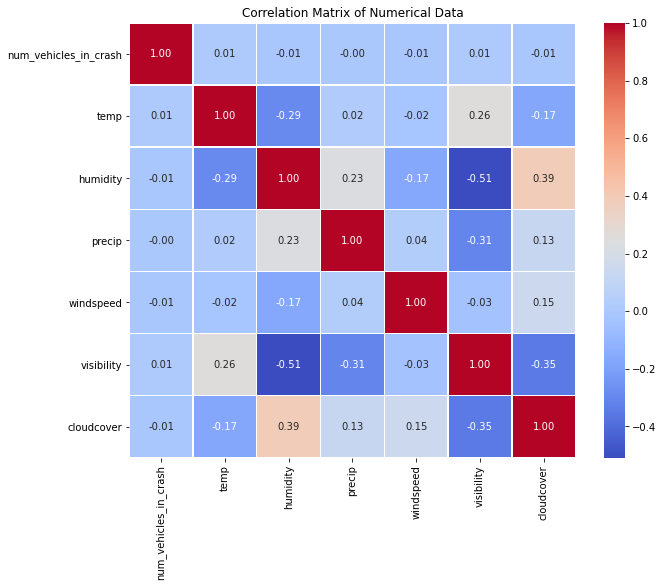

In [476]:
checker.visualize_correlation()

 # VISUALIZATION AND EDA

ASKING A COUPLE OF QUESTIONS ABOUT MY DATA

In [477]:
#this class does the visualisations and EDA
class VisualizationEDA:
    def __init__(self, df):
        self.df = df
    
    def create_map(self, df_subset_size=140000):
        df_subset = self.df.head(df_subset_size)
        map_center = [df_subset['lattitude'].mean(), df_subset['longitude'].mean()]
        mymap = folium.Map(location=map_center, zoom_start=12)
        marker_cluster = MarkerCluster().add_to(mymap)
        
        for index, row in df_subset.iterrows():
            folium.Marker([row['lattitude'], row['longitude']]).add_to(marker_cluster)
        
        return mymap
    
    def scatter_plots(self, data):
        fig, axs = plt.subplots(1, 2, figsize=(18, 6))

        colors = {'minor': 'black', 'major': 'lightblue'}

        # Plot for Total Killed
        scatter1 = axs[0].scatter(data.index, data['total_killed'], c=data['crash_severity'].map(colors), alpha=0.5, label='Crash Severity')
        axs[0].set_title('Scatter Plot of Total Killed with Severity Hue')
        axs[0].set_xlabel('Crash Index')
        axs[0].set_ylabel('Total Killed')

        # Plot for Total Injured
        scatter2 = axs[1].scatter(data.index, data['total_injured'], c=data['crash_severity'].map(colors), alpha=0.5, label='Crash Severity')
        axs[1].set_title('Scatter Plot of Total Injured with Severity Hue')
        axs[1].set_xlabel('Crash Index')
        axs[1].set_ylabel('Total Injured')

        legend_labels = list(colors.keys())
        legend_values = [plt.Line2D([0], [0], marker='o', color='w', label=label, markerfacecolor=colors[label], markersize=10) for label in legend_labels]
        fig.legend(handles=legend_values, labels=legend_labels, loc='upper right')

        plt.show()

    def calculate_crash_severity(self, data):
        incapacitating_mask = data['most_severe_injury'].str.contains('incapacitating injury', case=False, na=False)
        incapacitating_mask_2 = data['most_severe_injury'].str.contains('fatal', case=False, na=False)

        # Create 'crash_severity_2' column
        data['crash_severity_2'] = 'minor'  # Default to 'minor'
        data.loc[(data['total_killed'] > 0) | (data['total_injured'] > 6) | incapacitating_mask | incapacitating_mask_2, 'crash_severity_2'] = 'major'
        data.loc[(data['total_killed'] == -1) & (data['total_injured'] == -1) & ~incapacitating_mask_2 & ~incapacitating_mask, 'crash_severity_2'] = 'unknown'

        # Display unique values and counts of the 'crash_severity_2' column
        print(data['crash_severity_2'].value_counts())

        return data.head()
    
    def scatter_plots_with_severity(self, temp_data):
        fig, axs = plt.subplots(1, 2, figsize=(22, 6))

        colors = {'minor': '#02fb00', 'major': '#ff95ac', 'unknown': '#c4c4c4'}

        # Plot for Total Killed
        axs[0].scatter(temp_data.index, temp_data['total_killed'], c=temp_data['crash_severity_2'].map(colors), alpha=0.5)
        axs[0].set_title('Scatter Plot of Total Killed with Severity Hue')
        axs[0].set_xlabel('Crash Index')
        axs[0].set_ylabel('Total Killed')

        # Plot for Total Injured
        axs[1].scatter(temp_data.index, temp_data['total_injured'], c=temp_data['crash_severity_2'].map(colors), alpha=0.5)
        axs[1].set_title('Scatter Plot of Total Injured with Severity Hue')
        axs[1].set_xlabel('Crash Index')
        axs[1].set_ylabel('Total Injured')

        legend_labels = list(colors.keys())
        legend_values = [plt.Line2D([0], [0], marker='o', color='w', label=label, markerfacecolor=colors[label], markersize=10) for label in legend_labels]
        fig.legend(handles=legend_values, labels=legend_labels, loc='upper right')

        plt.show()
    
    def scatter_plots_with_severity_v2(self, temp_data):
        fig, axs = plt.subplots(1, 2, figsize=(22, 6))

        colors = {'minor': '#02fb00', 'major': '#ff95ac', 'unknown': '#c4c4c4'}

        # Plot for Total Killed
        axs[0].scatter(temp_data.index, temp_data['total_killed'], c=temp_data['crash_severity_2'].map(colors), alpha=0.5)
        axs[0].set_title('Scatter Plot of Total Killed with Severity Hue')
        axs[0].set_xlabel('Crash Index')
        axs[0].set_ylabel('Total Killed')

        # Plot for Total Injured
        axs[1].scatter(temp_data.index, temp_data['total_injured'], c=temp_data['crash_severity_2'].map(colors), alpha=0.5)
        axs[1].set_title('Scatter Plot of Total Injured with Severity Hue')
        axs[1].set_xlabel('Crash Index')
        axs[1].set_ylabel('Total Injured')

        legend_labels = list(colors.keys())
        legend_values = [plt.Line2D([0], [0], marker='o', color='w', label=label, markerfacecolor=colors[label], markersize=10) for label in legend_labels]
        fig.legend(handles=legend_values, labels=legend_labels, loc='upper right')

        plt.show()
eda = VisualizationEDA(df)
df_3 = df_2.copy()
data =  df_3.copy()
temp_data = data.copy()


In [478]:
# Convert columns to numeric, forcing errors to NaN
temp_data['total_killed'] = pd.to_numeric(temp_data['total_killed'], errors='coerce')
temp_data['total_injured'] = pd.to_numeric(temp_data['total_injured'], errors='coerce')

# Handle NaN values by filling with -1 (or any other appropriate value)
temp_data['total_killed'].fillna(-1, inplace=True)
temp_data['total_injured'].fillna(-1, inplace=True)

# Define masks for incapacitating injury and fatal injury
incapacitating_mask = temp_data['most_severe_injury'].str.contains('incapacitating injury', case=False, na=False)
incapacitating_mask_2 = temp_data['most_severe_injury'].str.contains('fatal', case=False, na=False)

# Create 'crash_severity_2' column
temp_data['crash_severity_2'] = 'minor'  # Default to 'minor'
temp_data.loc[(temp_data['total_killed'] > 0) | (temp_data['total_injured'] > 6) | incapacitating_mask | incapacitating_mask_2, 'crash_severity_2'] = 'major'
temp_data.loc[(temp_data['total_killed'] == -1) & (temp_data['total_injured'] == -1) & ~incapacitating_mask_2 & ~incapacitating_mask, 'crash_severity_2'] = 'unknown'

# Display unique values and counts of the 'crash_severity_2' column
print(temp_data['crash_severity_2'].value_counts())

# Display the first few rows of the dataframe
temp_data.head()


minor      332355
major       38769
unknown       873
Name: crash_severity_2, dtype: int64


,crash_date,crash_time,town,total_injured,total_killed,injury_incapacitated,most_severe_injury,crash_type,contributory_cause,sec_contributory_cause,...,road_defect,temp,humidity,precip,snowdepth,windspeed,visibility,cloudcover,conditions,crash_severity_2
0,07/18/19,10:35,harwood heights,0,0,0,no indication of injury,rear end,weather,unable to determine,...,no defects,72.6,92.9,0.354,0,6.9,1.8,54.6,"Rain, Partially cloudy",minor
1,07/21/19,13:45,englewood,0,0,0,no indication of injury,rear end,unable to determine,not applicable,...,unknown,72.3,95.0,0.199,0,11.4,7.4,87.4,"Rain, Partially cloudy",minor
2,07/21/19,16:00,cragin,0,0,0,no indication of injury,sideswipe same direction,improper overtaking/passing,improper turning/no signal,...,no defects,74.6,71.6,0.029,0,13.7,9.9,58.2,"Rain, Partially cloudy",minor
3,07/21/19,16:45,cragin,0,0,0,no indication of injury,turning,unable to determine,not applicable,...,no defects,74.5,72.2,0.030,0,13.7,9.9,58.3,"Rain, Partially cloudy",minor
4,07/21/19,23:05,cicero,0,0,0,no indication of injury,turning,unable to determine,not applicable,...,unknown,66.5,59.4,0.000,0,4.9,9.9,0.0,Clear,minor


In [479]:
#This class does the ploting for the visuals
class TimeSeriesAnalysis:
    def __init__(self, temp_data):
        self.temp_data = temp_data
        self.temp_data['crash_time'] = pd.to_datetime(self.temp_data['crash_time'], format='%H:%M', errors='coerce')
        self.temp_data['crash_date'] = pd.to_datetime(self.temp_data['crash_date'], format='%m/%d/%y')
        self.temp_data['crash_day'] = self.temp_data['crash_date'].dt.day_name()
    
    def plot_crash_time_distribution(self):
        plt.figure(figsize=(10, 6))
        plt.hist(self.temp_data['crash_time'].dt.hour, bins=24, edgecolor='black', alpha=0.7)
        plt.title('Distribution of Crashes During Different Parts of the Day')
        plt.xlabel('Hour of the Day')
        plt.ylabel('Number of Crashes')
        plt.xticks(range(24), [f'{hour:02}:00' for hour in range(24)], rotation=45)
        plt.grid(axis='y', linestyle='--', alpha=0.7)
        plt.show()

    def plot_total_killed_and_injured_by_hour(self):
        fd = self.temp_data[(self.temp_data['total_killed'] >= 0) & (self.temp_data['total_injured'] >= 0)]
        hourly_data = fd.groupby(fd['crash_time'].dt.hour)[['total_killed', 'total_injured']].sum()

        plt.figure(figsize=(12, 5))

        # Plot for total killed
        plt.subplot(1, 2, 1)
        hourly_data['total_killed'].plot(kind='bar', color='lightsalmon')
        plt.title('Total Killed by Hour')
        plt.xlabel('Hour of the Day')
        plt.ylabel('Count')

        # Plot for total injured
        plt.subplot(1, 2, 2)
        hourly_data['total_injured'].plot(kind='bar', color='lightsteelblue')
        plt.title('Total Injured by Hour')
        plt.xlabel('Hour of the Day')
        plt.ylabel('Count')

        plt.tight_layout()
        plt.show()

    def plot_crashes_by_day_of_week(self):
        crash_day_counts = self.temp_data['crash_day'].value_counts()
        sorted_days = list(calendar.day_name)

        plt.figure(figsize=(10, 6))
        crash_day_counts.loc[sorted_days].plot(kind='bar', color='skyblue', edgecolor='black')
        plt.title('Number of Crashes by Day of the Week')
        plt.xlabel('Day of the Week')
        plt.ylabel('Number of Crashes')
        plt.show()

    def plot_fatal_incapacitating_injuries_by_weekday(self):
        fatal_incapacitating_counts = self.temp_data['most_severe_injury'].isin(['fatal', 'incapacitating injury']).groupby(self.temp_data['crash_day']).sum()
        fatal_incapacitating_table = pd.DataFrame({'Weekday': fatal_incapacitating_counts.index, 'Total Fatal/Incapacitating': fatal_incapacitating_counts.values})

        weekday_order = list(calendar.day_name)
        fatal_incapacitating_table['Weekday'] = pd.Categorical(fatal_incapacitating_table['Weekday'], categories=weekday_order, ordered=True)
        fatal_incapacitating_table = fatal_incapacitating_table.sort_values('Weekday')

        plt.figure(figsize=(10, 6))
        plt.bar(fatal_incapacitating_table['Weekday'], fatal_incapacitating_table['Total Fatal/Incapacitating'], color='#F9ABAB')
        plt.title('Fatal and Incapacitating Injuries by Weekday')
        plt.xlabel('Weekday')
        plt.ylabel('Total Fatal/Incapacitating Injuries')
        plt.show()



ts_analysis = TimeSeriesAnalysis(temp_data)



In [480]:
class CrashAnalysis:
    def __init__(self, temp_data):
        """
        Initialize the CrashAnalysis class with a DataFrame containing crash data.

        Parameters:
        temp_data (pd.DataFrame): The DataFrame containing the crash data.
        """
        self.temp_data = temp_data
    
    def plot_top_contributory_causes(self):
        """
        Plot the top 15 contributory causes of crashes, excluding 'unable to determine' and 'not applicable'.
        """
        # Filter out rows where the contributory cause is 'unable to determine' or 'not applicable'
        filtered_contributory_causes = self.temp_data[~self.temp_data['contributory_cause'].isin(['unable to determine', 'not applicable'])]
        
        # Get the top 15 contributory causes
        top_contributory_causes = filtered_contributory_causes['contributory_cause'].value_counts().head(15)

        # Plot the top 15 contributory causes
        plt.figure(figsize=(12, 6))
        top_contributory_causes.plot(kind='bar', color='blue', alpha=0.7)
        plt.title('Top 15 Contributory Causes of Crashes')
        plt.xlabel('Contributory Cause')
        plt.ylabel('Frequency')
        plt.xticks(rotation=45, ha='right')
        plt.grid(axis='y', linestyle='--', alpha=0.7)
        plt.show()

    def plot_top_towns(self):
        """
        Plot the top 15 towns with the highest crash frequency.
        """
        # Get the top 15 towns with the highest crash frequency
        top_towns = self.temp_data['town'].value_counts().head(15)

        # Plot the top 15 towns
        plt.figure(figsize=(12, 6))
        bar_plot = sns.barplot(x=top_towns.index, y=top_towns.values)
        plt.title('Top 15 Areas with the Highest Crash Frequency')
        plt.xlabel('Town')
        plt.ylabel('Number of Crashes')
        plt.xticks(rotation=45, ha='right')
        plt.show()

    def plot_weather_conditions_distribution(self):
        """
        Plot the distribution of weather conditions in weather-related crashes.
        """
        # Filter the data for weather-related crashes
        weather_data = self.temp_data[self.temp_data['contributory_cause'] == 'weather']
        
        # Get the counts of different weather conditions
        weather_conditions = weather_data['conditions'].value_counts()

        # Plot the distribution of weather conditions in weather-related crashes
        plt.figure(figsize=(10, 6))
        weather_conditions.plot(kind='bar', color='skyblue')
        plt.title('Distribution of Weather Conditions in Weather-Related Crashes')
        plt.xlabel('Weather Conditions')
        plt.ylabel('Number of Crashes')
        plt.xticks(rotation=45, ha='right')
        plt.tight_layout()
        plt.show()
    
    def plot_crash_severity_by_conditions(self):
        """
        Plot the distribution of crashes across different conditions by severity.
        """
        # Check if 'crash_severity_2' column exists
        if 'crash_severity_2' not in self.temp_data.columns:
            print("Error: 'crash_severity_2' column not found in the dataset.")
            return

        # Plot the count of crashes for each condition, separated by severity
        plt.figure(figsize=(14, 8))
        sns.countplot(x='conditions', hue='crash_severity_2', data=self.temp_data, 
                      order=self.temp_data['conditions'].value_counts().index, palette='viridis')
        plt.title('Distribution of Crashes Across Conditions by Severity')
        plt.xlabel('Conditions')
        plt.ylabel('Number of Crashes')
        plt.xticks(rotation=45, ha='right')
        plt.legend(title='Crash Severity', loc='upper right')
        plt.show()

    def plot_weather_conditions_vs_crashes(self):
        """
        Plot histograms of weather conditions (humidity, windspeed, visibility, cloudcover) against total crashes,
        and plot distributions of snow depth and precipitation with corresponding crash counts.
        """
        # Define weather-related columns
        weather_columns = ['humidity', 'windspeed', 'visibility', 'cloudcover']

        num_bins = 20

        # Plot weather conditions histograms
        fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(16, 10))
        fig.suptitle('Weather Conditions vs Total Crashes', fontsize=16)

        axes = axes.flatten()

        for i, column in enumerate(weather_columns):
            filtered_data = self.temp_data[self.temp_data[column].notnull()]

            sns.histplot(x=column, data=filtered_data, bins=num_bins, kde=True, ax=axes[i], color='skyblue')
            axes[i].set_title(f'{column.capitalize()} Distribution')
            axes[i].set_xlabel(column.capitalize())
            axes[i].set_ylabel('Total Crashes')

        plt.tight_layout(rect=[0, 0.03, 1, 0.95])
        plt.show()

        # Convert 'snowdepth' and 'precip' columns to numeric
        self.temp_data['snowdepth'] = pd.to_numeric(self.temp_data['snowdepth'], errors='coerce')
        self.temp_data['precip'] = pd.to_numeric(self.temp_data['precip'], errors='coerce')

        # Filter out NaN values after conversion
        snowy_data = self.temp_data[self.temp_data['snowdepth'].notnull() & (self.temp_data['snowdepth'] > 0)]
        precip_data = self.temp_data[self.temp_data['precip'].notnull() & (self.temp_data['precip'] > 0)]

        fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(16, 6))

        axes[0].hist(snowy_data['snowdepth'], bins=30, color='skyblue', edgecolor='black')
        axes[0].set_title('Distribution of Snow Depth and Corresponding Crash Counts (>0)')
        axes[0].set_xlabel('Snow Depth')
        axes[0].set_ylabel('Crash Counts')
        axes[0].grid(axis='y', linestyle='--', alpha=0.7)

        axes[1].hist(precip_data['precip'], bins=30, color='lightgreen', edgecolor='black')
        axes[1].set_title('Distribution of Precipitation and Corresponding Crash Counts (>0)')
        axes[1].set_xlabel('Precipitation')
        axes[1].set_ylabel('Crash Counts')
        axes[1].grid(axis='y', linestyle='--', alpha=0.7)

        plt.tight_layout()
        plt.show()

# Initialize the CrashAnalysis class with the crash data
crash_analysis = CrashAnalysis(temp_data)



In [481]:
#This class does EDA and visuals
class CrashSeasonAnalysis:
    def __init__(self, temp_data):
        self.temp_data = temp_data

    def plot_crash_count_by_month_and_year(self):
        self.temp_data['crash_date'] = pd.to_datetime(self.temp_data['crash_date'])
        self.temp_data['year'] = self.temp_data['crash_date'].dt.year
        self.temp_data['month'] = self.temp_data['crash_date'].dt.month_name()

        filtered_data = self.temp_data[self.temp_data['year'] != 2018]

        month_order = ['January', 'February', 'March', 'April', 'May', 'June', 'July', 'August', 'September', 'October', 'November', 'December']

        crash_count_table = filtered_data.groupby(['year', 'month']).size().reset_index(name='crash_count')
        crash_count_table['month'] = pd.Categorical(crash_count_table['month'], categories=month_order, ordered=True)

        pivot_data = crash_count_table.pivot(index='year', columns='month', values='crash_count').fillna(0)

        plt.figure(figsize=(10, 4))
        sns.heatmap(pivot_data, cmap='magma', annot=True, fmt='g', cbar_kws={'label': 'Crash Count'})
        plt.title('Crash Count by Month and Year')
        plt.xlabel('Month')
        plt.ylabel('Year')
        plt.xticks(rotation=45, ha='right')
        plt.show()
        
        return pivot_data

    def plot_temperature_vs_injuries_and_deaths(self):
        def get_season(month):
            if 3 <= month <= 5:
                return 'Spring'
            elif 6 <= month <= 8:
                return 'Summer'
            elif 9 <= month <= 11:
                return 'Fall'
            else:
                return 'Winter'

        self.temp_data['season'] = self.temp_data['crash_date'].dt.month.apply(get_season)

        season_colors = {'Winter': '#4D95C4', 'Spring': '#E793EC', 'Summer': '#76E683', 'Fall': '#E7BF57'}

        self.temp_data['temp_cels'] = (self.temp_data['temp'] - 32) * 5 / 9

        filtered_data_injured = self.temp_data[self.temp_data['total_injured'] >= 0]

        plt.figure(figsize=(16, 6))

        plt.subplot(1, 2, 1)
        sns.scatterplot(x='temp_cels', y='total_injured', data=filtered_data_injured, alpha=0.5, palette=season_colors, hue='season', legend='full')
        plt.title('Scatter Plot of Temperature (°C) vs Total Injured')
        plt.xlabel('Temperature')
        plt.ylabel('Total Injured')

        filtered_data_killed = self.temp_data[self.temp_data['total_killed'] >= 0]

        plt.subplot(1, 2, 2)
        sns.scatterplot(x='temp_cels', y='total_killed', data=filtered_data_killed, alpha=0.5, palette=season_colors, hue='season', legend='full')
        plt.title('Scatter Plot of Temperature (°C) vs Total Killed')
        plt.xlabel('Temperature')
        plt.ylabel('Total Killed')

        plt.tight_layout()
        plt.show()

    def plot_most_fatal_crash_types(self):
        crash_type_summary = self.temp_data[self.temp_data['total_killed'] >= 0].groupby('crash_type')['total_killed'].sum().reset_index()
        crash_type_summary.columns = ['crash_type', 'total_killed']
        crash_type_summary = crash_type_summary.sort_values(by='total_killed', ascending=False)

        sorted_crash_types = crash_type_summary.sort_values(by='total_killed', ascending=False)

        top_n = 8
        selected_crash_types = sorted_crash_types.head(top_n)

        plt.figure(figsize=(8, 8))
        colors = sns.color_palette('Set2', n_colors=top_n)
        plt.pie(selected_crash_types['total_killed'], labels=selected_crash_types['crash_type'], autopct='%1.1f%%', startangle=140, colors=colors)
        plt.title('Most Fatal Crash Types')
        plt.show()
        
        return crash_type_summary

    def get_crash_type_summary(self):
        crash_type_summary = self.temp_data[self.temp_data['total_killed'] >= 0].groupby('crash_type')['total_killed'].sum().reset_index()
        crash_type_summary.columns = ['crash_type', 'total_killed']
        crash_type_summary = crash_type_summary.sort_values(by='total_killed', ascending=False)
        return crash_type_summary

# Initialize the CrashSeasonAnalysis class with the crash data
crash_season_analysis = CrashSeasonAnalysis(temp_data)



In [482]:
class CrashCauseAnalysis:
    def __init__(self, temp_data):
        """
        Initialize the CrashCauseAnalysis class with a DataFrame containing crash data.
        
        Parameters:
        temp_data (pd.DataFrame): The DataFrame containing the crash data.
        """
        self.temp_data = temp_data

    def get_contributory_cause_table(self):
        """
        Generate a table summarizing the total killed and total crashes for each contributory cause,
        along with the death ratio.
        
        Returns:
        pd.DataFrame: The contributory cause table sorted by total killed.
        """
        contributory_cause_table = self.temp_data[self.temp_data['total_killed'] >= 0].groupby('contributory_cause').agg({
            'total_killed': 'sum',
            'contributory_cause': 'count'
        }).rename(columns={'contributory_cause': 'total_crashes'}).reset_index()
        
        contributory_cause_table['death_ratio'] = (contributory_cause_table['total_killed'] / contributory_cause_table['total_crashes']) * 100
        contributory_cause_table = contributory_cause_table.sort_values(by='total_killed', ascending=False)
        return contributory_cause_table

    def plot_top_conditions(self):
        """
        Plot the top 6 conditions by total killed and by death ratio.
        """
        contributory_cause_table = self.get_contributory_cause_table()
        
        top_conditions_total_killed = contributory_cause_table.sort_values('total_killed', ascending=False).head(6)
        top_conditions_death_ratio = contributory_cause_table.sort_values('death_ratio', ascending=False).head(6)
        
        fig, axes = plt.subplots(1, 2, figsize=(16, 6))

        sns.barplot(x='total_killed', y='contributory_cause', data=top_conditions_total_killed, ax=axes[0], palette='viridis')
        axes[0].set_title('Top 6 Conditions by Total Killed')
        axes[0].set_xlabel('Total Killed')
        axes[0].set_ylabel('Condition')

        sns.barplot(x='death_ratio', y='contributory_cause', data=top_conditions_death_ratio, ax=axes[1], palette='plasma')
        axes[1].set_title('Top 6 Conditions by Death Ratio')
        axes[1].set_xlabel('Death Ratio (%)')
        axes[1].set_ylabel('Condition')

        plt.tight_layout()
        plt.show()

    def plot_avg_vehicles_by_cause(self):
        """
        Plot the average number of vehicles in crashes by contributory cause.
        """
        filtered_data = self.temp_data.sort_values('num_vehicles_in_crash', ascending=False).head(16)
        avg_vehicles_by_cause = filtered_data.groupby('contributory_cause')['num_vehicles_in_crash'].mean().reset_index()
        avg_vehicles_by_cause = avg_vehicles_by_cause.sort_values(by='num_vehicles_in_crash', ascending=False).head(7)

        plt.figure(figsize=(12, 6))
        plt.bar(avg_vehicles_by_cause['contributory_cause'], avg_vehicles_by_cause['num_vehicles_in_crash'], color='skyblue')
        plt.xlabel('Contributory Cause')
        plt.ylabel('Average Number of Vehicles in Crash')
        plt.title('Average Number of Vehicles in Crash by Contributory Cause')
        plt.xticks(rotation=45, ha='right')
        plt.show()

    def get_traffic_control_device_table(self):
        """
        Generate a table summarizing the total killed and total crashes for each traffic control device,
        along with the death ratio.
        
        Returns:
        pd.DataFrame: The traffic control device table sorted by death ratio.
        """
        traffic_control_device_table = self.temp_data[self.temp_data['total_killed'] >= 0].groupby('traffic_control_device').agg({
            'total_killed': 'sum',
            'traffic_control_device': 'count'
        }).rename(columns={'traffic_control_device': 'total_crashes'}).reset_index()

        traffic_control_device_table['death_ratio'] = (traffic_control_device_table['total_killed'] / traffic_control_device_table['total_crashes']) * 100
        traffic_control_device_table_sorted = traffic_control_device_table.sort_values(by='death_ratio', ascending=False)
        return traffic_control_device_table_sorted


# Initialize the CrashCauseAnalysis class with the crash data
crash_cause_analysis = CrashCauseAnalysis(temp_data)



# **1. At what time of day are crashes most frequent?**

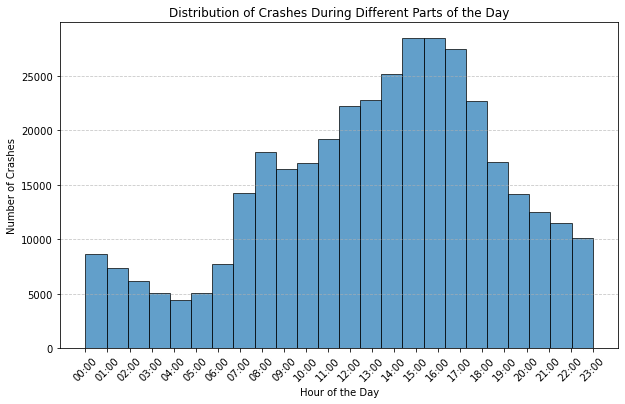

In [483]:
# Plot crash time distribution
ts_analysis.plot_crash_time_distribution()

Peak Hours: The highest number of crashes occurs between approximately 14:00 and 17:00 (2:00 PM to 5:00 PM). This time frame experiences the most frequent accidents during the day.

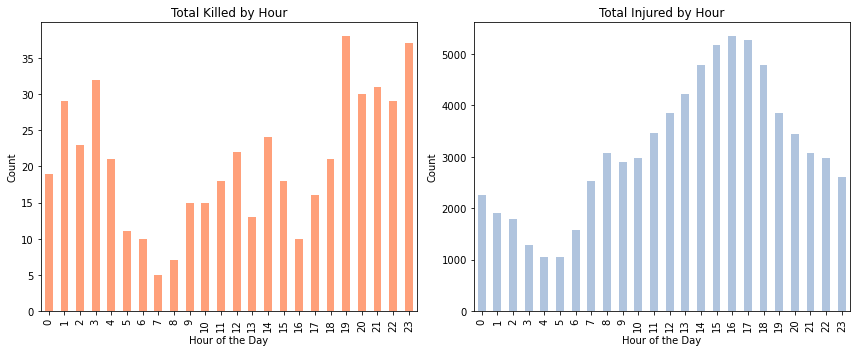

In [484]:
# Plot total killed and injured by hour
ts_analysis.plot_total_killed_and_injured_by_hour()

Although crash and injury rates peak at 2:00 PM and 5:00 PM, likely because of the afternoon commute and increased traffic, it's significant to note that nighttime hours, despite having lighter traffic, may have a higher risk of severe accidents.

In [485]:
# Calculate crash severity
updated_data = eda.calculate_crash_severity(temp_data)

minor      332355
major       38769
unknown       873
Name: crash_severity_2, dtype: int64


# **2. Which locations experience the highest number of crashes?**

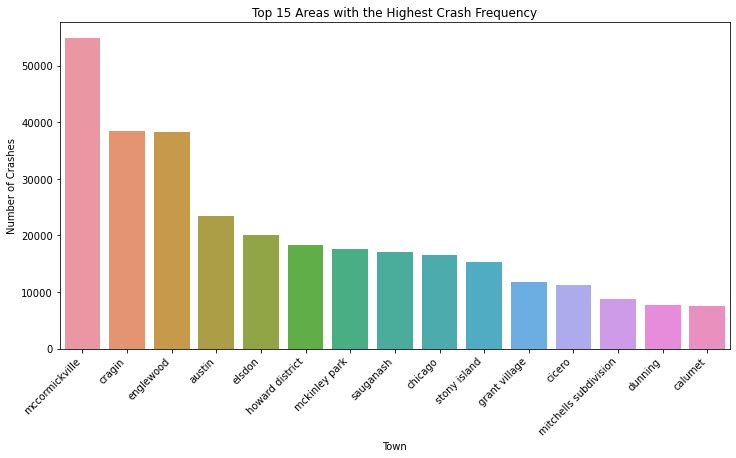

In [486]:
# Plot top towns with the highest crash frequency
crash_analysis.plot_top_towns()


In [487]:
# Create a map
mymap_2 = eda.create_map()

# Display the map (Jupyter Notebook environment)
mymap_2

# **3. How do different weather conditions affect the frequency of crashes?**

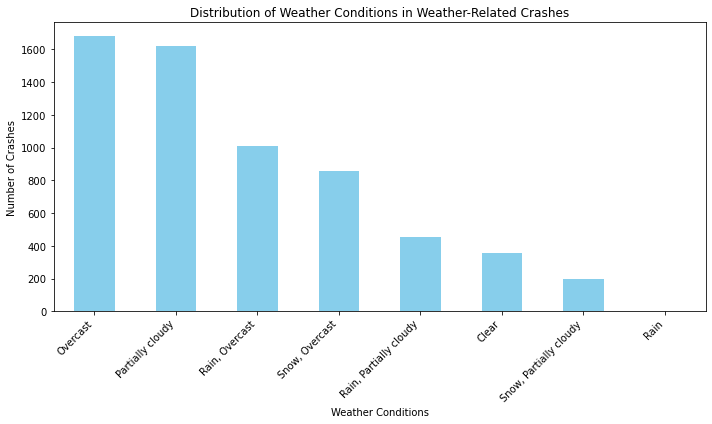

In [488]:
# Plot distribution of weather conditions in weather-related crashes
crash_analysis.plot_weather_conditions_distribution()

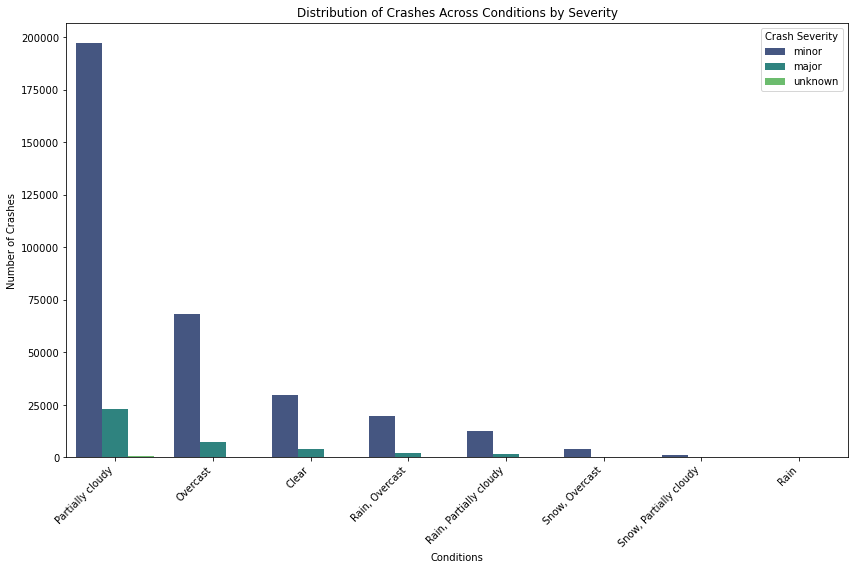

In [489]:
# Plot crash severity by conditions
crash_analysis.plot_crash_severity_by_conditions()

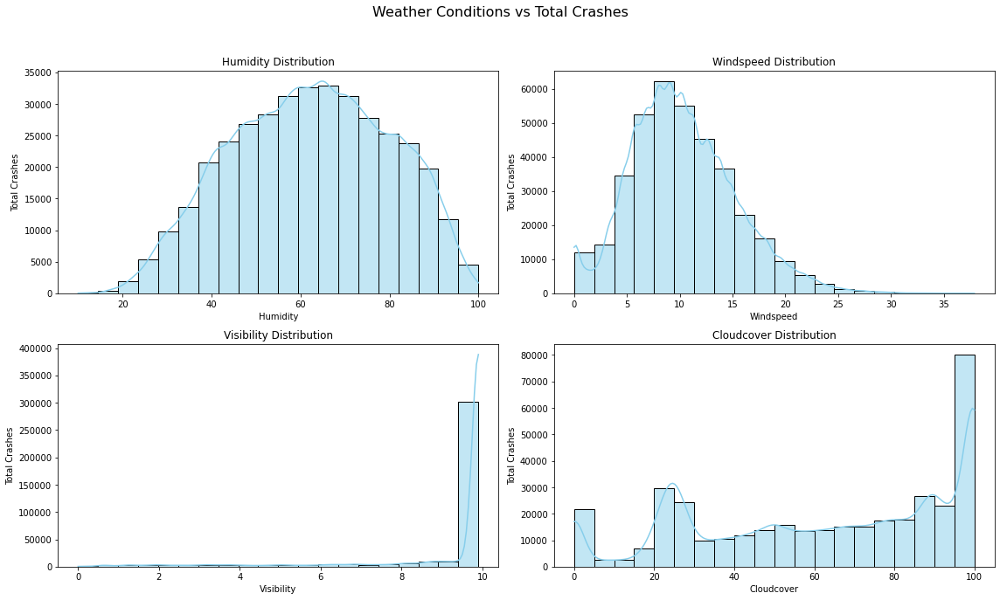

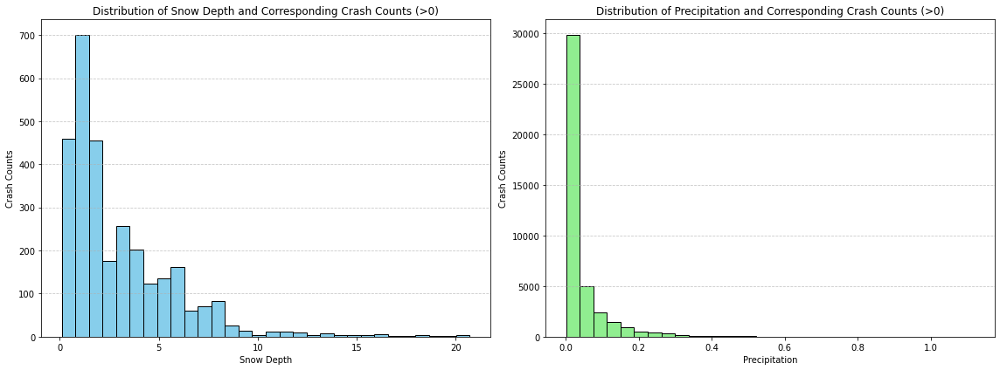

In [490]:
# Plot weather conditions vs total crashes
crash_analysis.plot_weather_conditions_vs_crashes()

Road accidents occur most frequently under the following conditions

Humidity: 55 - 70

Windspeed: 5.5-12.5

Visibility: 10

Cloud Cover: 100

Snow Depth: 0 - 0.1

Precipation: 0.0 - 0.1

# **4. During which months or seasons do crashes occur most frequently?**

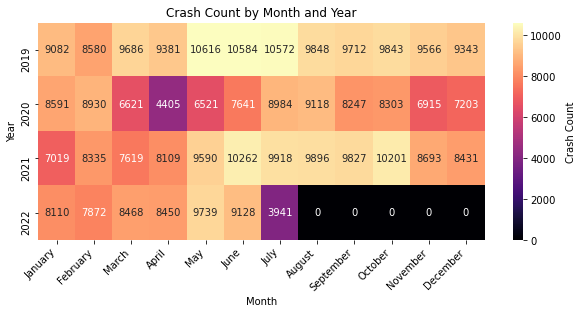

month,January,February,March,April,May,June,July,August,September,October,November,December
year,,,,,,,,,,,,
2019,9082.0,8580.0,9686.0,9381.0,10616.0,10584.0,10572.0,9848.0,9712.0,9843.0,9566.0,9343.0
2020,8591.0,8930.0,6621.0,4405.0,6521.0,7641.0,8984.0,9118.0,8247.0,8303.0,6915.0,7203.0
2021,7019.0,8335.0,7619.0,8109.0,9590.0,10262.0,9918.0,9896.0,9827.0,10201.0,8693.0,8431.0
2022,8110.0,7872.0,8468.0,8450.0,9739.0,9128.0,3941.0,0.0,0.0,0.0,0.0,0.0


In [491]:
# Plot crash count by month and year
crash_season_analysis.plot_crash_count_by_month_and_year()

**Seasonal Trends:**
Generally, there are more crashes in the middle of the year (around June to October) across all years presented.
This pattern suggests that certain months experience higher traffic or risk factors.

**Yearly Variation:**
In 2020, there’s a noticeable decrease in crash counts compared to other years. This could be due to reduced travel during the COVID-19 pandemic.
The crash counts in 2021 and 2022 seem to follow a similar pattern.

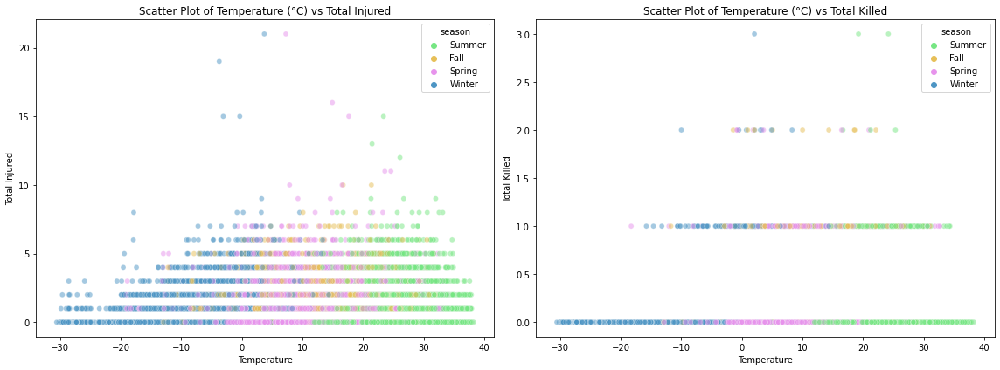

In [492]:
# Plot temperature vs injuries and deaths
crash_season_analysis.plot_temperature_vs_injuries_and_deaths()

# **5. What are the primary contributory causes of crashes?**

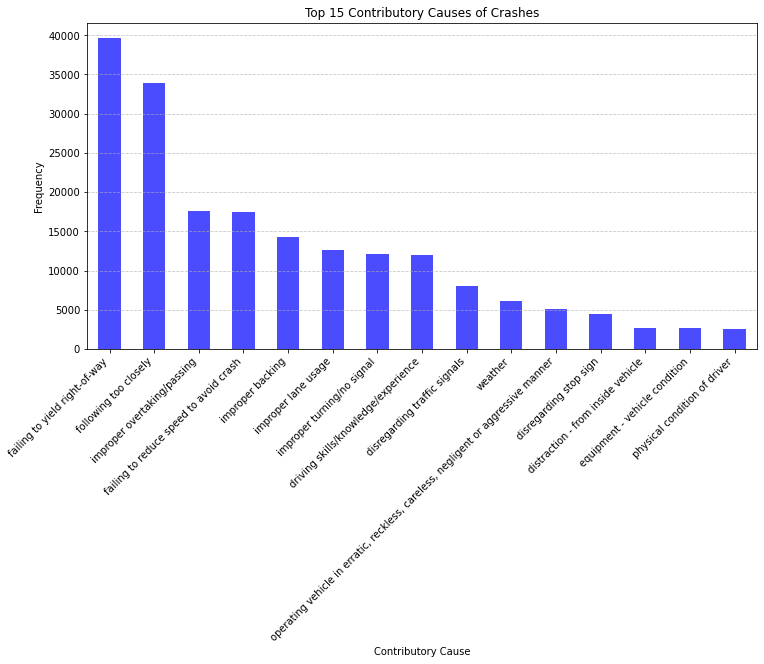

In [493]:
# Plot top contributory causes of crashes
crash_analysis.plot_top_contributory_causes()

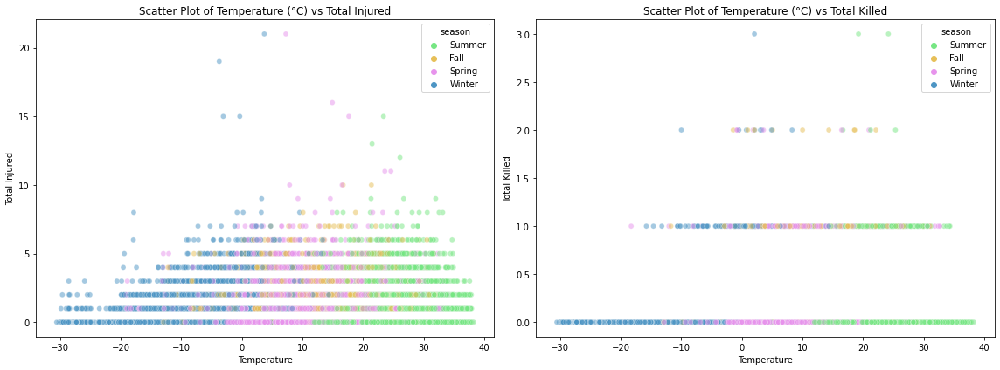

In [494]:
# Plot temperature vs injuries and deaths
crash_season_analysis.plot_temperature_vs_injuries_and_deaths()

# **6. How are crashes distributed across the days of the week, and which day experiences the most crashes?**

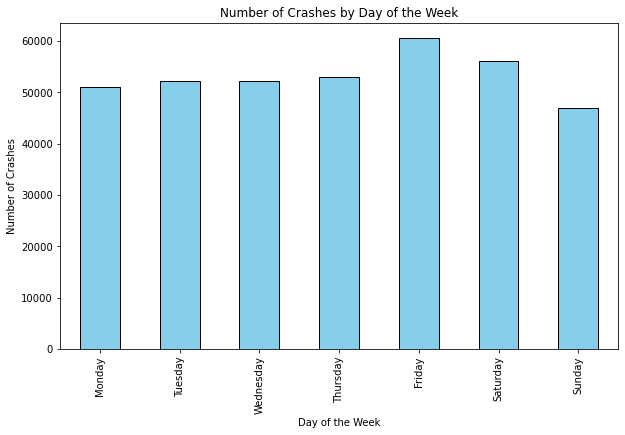

In [495]:
# Plot crashes by day of the week
ts_analysis.plot_crashes_by_day_of_week()

Friday has the highest overall number of crashes

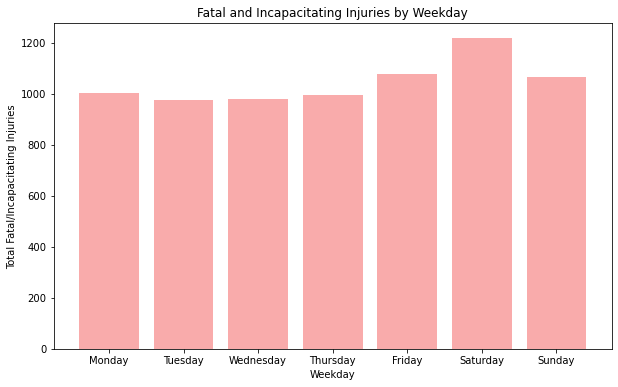

In [496]:
# Plot fatal and incapacitating injuries by weekday
ts_analysis.plot_fatal_incapacitating_injuries_by_weekday()

Friday records the highest total number of crashes, whereas Saturday is distinguished by the highest incidence of fatal injuries.

# **7. Which types of crashes result in the highest fatalities?**

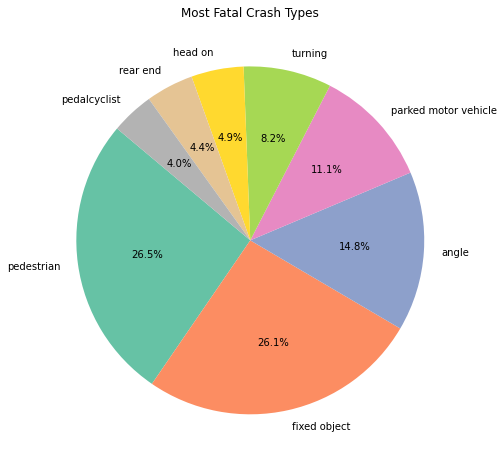

,crash_type,total_killed
9,pedestrian,120
2,fixed object,118
0,angle,67
7,parked motor vehicle,50
17,turning,37
3,head on,22
10,rear end,20
8,pedalcyclist,18
15,sideswipe same direction,18
5,other object,11


In [497]:
crash_season_analysis.plot_most_fatal_crash_types()

# **8. Which contributory cause poses the greatest danger?*

In [498]:
# Get contributory cause table
contributory_cause_table = crash_cause_analysis.get_contributory_cause_table()
contributory_cause_table

,contributory_cause,total_killed,total_crashes,death_ratio
36,unable to determine,164,145998,0.112330
6,disregarding traffic signals,50,8075,0.619195
17,failing to reduce speed to avoid crash,47,17475,0.268956
30,physical condition of driver,47,2496,1.883013
18,failing to yield right-of-way,42,39590,0.106087
26,not applicable,39,19613,0.198848
28,"operating vehicle in erratic, reckless, carele...",28,5071,0.552159
37,under the influence of alcohol/drugs (use when...,9,2088,0.431034
23,improper overtaking/passing,9,17572,0.051218
22,improper lane usage,8,12673,0.063126


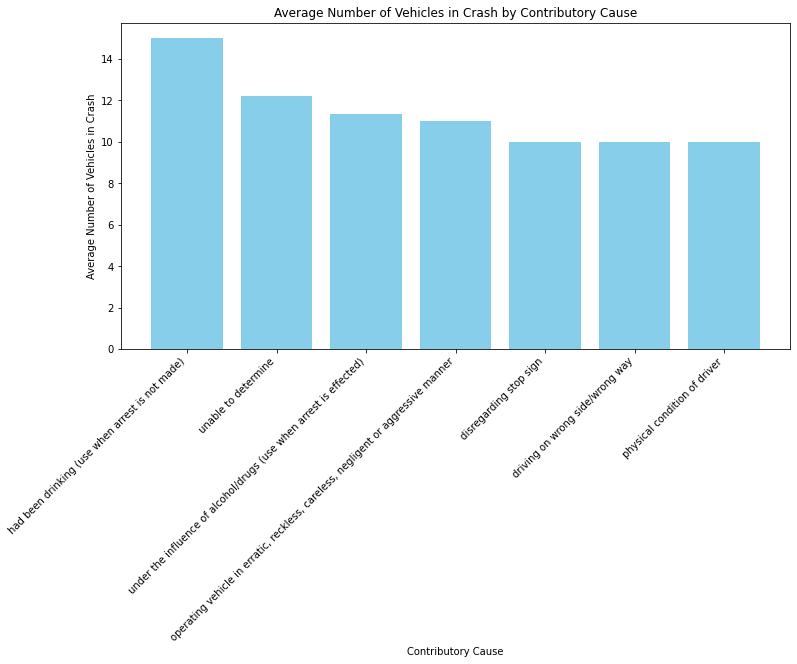

In [499]:
# Plot average number of vehicles in crashes by contributory cause
crash_cause_analysis.plot_avg_vehicles_by_cause()

Most incidents involving vehicle damage typically coincide with instances where drivers are under the influence of alcohol or drugs, or when they exhibit reckless driving behavior.

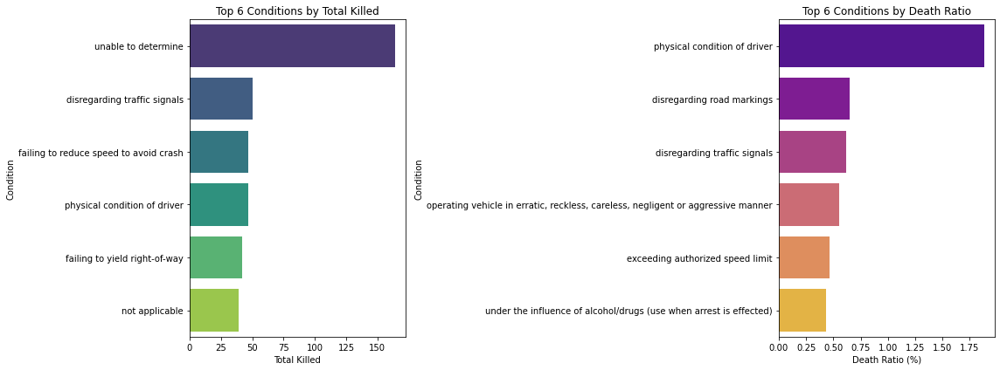

In [500]:
# Plot top conditions
crash_cause_analysis.plot_top_conditions()

 “Disregarding traffic signals” and “failing to reduce speed to avoid a crash” contribute significantly to fatalities.

“Physical condition of the driver” and “failing to yield right-of-way” are also among the top conditions.

“Disregarding road markings” has the highest death ratio, indicating that when this condition occurs, it often leads to fatalities.

Other high-risk conditions include “driving on the wrong side of the road,” “disregarding traffic signals,” and “operating the vehicle in an erratic, reckless, careless, negligent, or aggressive manner.”

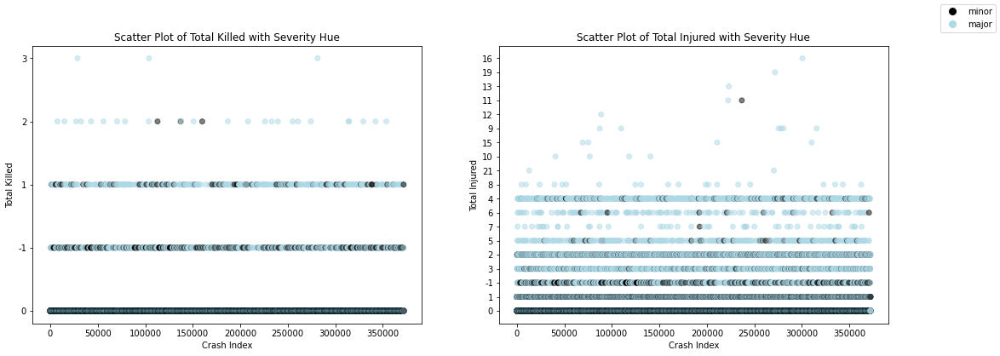

In [501]:
# Generate scatter plots
eda.scatter_plots(data)

In [502]:
# Calculate crash severity
updated_data = eda.calculate_crash_severity(temp_data)

minor      332355
major       38769
unknown       873
Name: crash_severity_2, dtype: int64


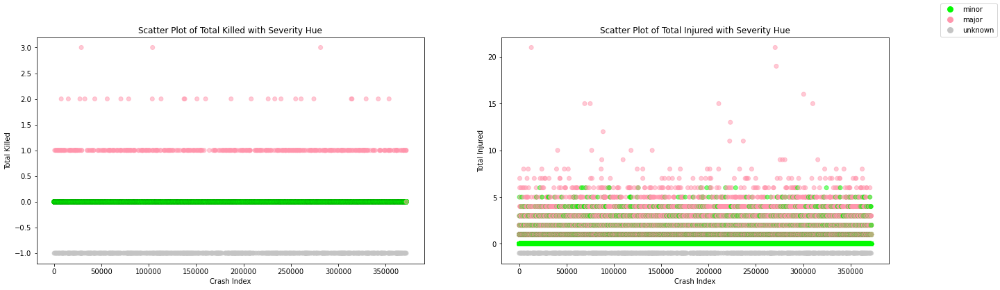

In [503]:
# Generate scatter plots with new severity hues (v2)
eda.scatter_plots_with_severity_v2(temp_data)

# **9. Does the presence of traffic control measures reduce the likelihood of crashes?**

In [504]:
# Get traffic control device table
traffic_control_device_table_sorted = crash_cause_analysis.get_traffic_control_device_table()
traffic_control_device_table_sorted


,traffic_control_device,total_killed,total_crashes,death_ratio
12,railroad crossing gate,3,236,1.271186
10,pedestrian crossing sign,3,335,0.895522
11,police/flagman,1,128,0.781250
6,other,7,2450,0.285714
18,yield,1,516,0.193798
16,traffic signal,159,103029,0.154325
4,no controls,274,212125,0.129169
15,stop sign/flasher,38,37828,0.100455
17,unknown,8,12855,0.062233
14,school zone,0,112,0.000000


In [506]:
count_occurrences = df_2.apply(lambda x: (x == 'NaN').sum())


with pd.option_context('display.max_rows', None, 'display.max_columns', None):
    print(count_occurrences)

crash_date                          0
crash_time                          0
town                                0
total_injured                       0
total_killed                        0
injury_incapacitated                0
most_severe_injury                  0
crash_type                          0
contributory_cause                  0
sec_contributory_cause              0
num_vehicles_in_crash               0
crash_hit_and_run                   0
crash_severity                      0
traffic_control_device              0
traffic_control_device_condition    0
road_defect                         0
temp                                0
humidity                            0
precip                              0
snowdepth                           0
windspeed                           0
visibility                          0
cloudcover                          0
conditions                          0
dtype: int64


# Insights from EDA (Exploratory Data Analysis) of Crash Data

## Time:
- **Peak Hours:** Most crashes and injuries occur during peak afternoon commute hours (2:00 PM - 5:00 PM), reflecting the expected high traffic volume.
- **Nighttime Risks:** Nighttime crashes, despite lower traffic, show a higher risk of severe injuries. This suggests factors like reduced visibility and headlight limitations contribute significantly to nighttime dangers.

## Day of Week:
- **Friday Frequency:** Crashes are most frequent on Fridays, likely due to increased weekend travel activity.
- **Saturday Fatalities:** Saturdays see the most fatalities, highlighting the need for heightened awareness and safety measures during weekends.

## Contributing Factors:
- **Common Causes:** Common crash causes include right-of-way issues, improper following distance, unsafe overtaking, speeding, and risky backing maneuvers. These areas call for improved driver education and stricter traffic enforcement.

## Weather and Season:
- **Seasonal Trends:** Crashes occur frequently in spring and early summer, challenging the assumption that autumn's wet weather poses the greatest risk.
- **Resource Allocation:** This seasonal insight can inform strategic allocation of resources for road safety campaigns and infrastructure improvements.

## Fatalities:
- **High-Risk Collisions:** Collisions with fixed objects and pedestrian accidents have a higher chance of fatalities, urging interventions to protect vulnerable road users and improve safety in these collision-prone areas.
- **Driver Behavior:** Driver impairment and disregarding traffic signals are leading factors in fatalities, highlighting crucial areas for intervention to reduce severe outcomes.

## Environmental Factors:
- **Mild Weather:** Crashes are most frequent in mild weather, contradicting the assumption that bad weather is the primary cause. This necessitates further investigation into the factors contributing to accidents during favorable weather conditions.

# Advice to Drivers
1. **Awareness During Peak Hours:** Stay extra vigilant during peak afternoon commute hours. Avoid distractions and maintain safe following distances.
2. **Nighttime Driving:** Ensure your vehicle’s headlights are in good working condition. Reduce speed and increase awareness when driving at night.
3. **Weekend Caution:** Exercise heightened caution when driving on Fridays and Saturdays. Be aware of increased traffic and potential for impaired drivers.
4. **Safe Driving Practices:** Follow traffic rules strictly. Avoid speeding, maintain safe distances, and use turn signals properly.
5. **Weather Conditions:** Drive carefully even in mild weather. Do not assume that good weather conditions equate to lower accident risk.

# Recommendations to Chicago Department of Transport
1. **Enhanced Enforcement During Peak Hours:** Increase traffic enforcement during peak afternoon commute hours to manage high traffic volumes effectively.
2. **Nighttime Safety Measures:** Implement additional street lighting and reflective road signs in areas prone to nighttime accidents. Promote the use of high-visibility gear for pedestrians and cyclists.
3. **Weekend Safety Campaigns:** Launch targeted safety campaigns on Fridays and Saturdays to raise awareness about the increased risk of crashes and fatalities.
4. **Driver Education Programs:** Develop and promote driver education programs focusing on common crash causes such as right-of-way issues, safe following distances, and proper overtaking.
5. **Seasonal Resource Allocation:** Allocate resources strategically for road safety campaigns and infrastructure improvements based on the seasonal trends identified.
6. **Protecting Vulnerable Road Users:** Implement protective measures for pedestrians and cyclists, such as dedicated lanes and improved crosswalks. Focus on areas with high incidences of collisions with fixed objects.
7. **Addressing Mild Weather Crashes:** Investigate and address factors contributing to crashes in mild weather conditions. Consider road design improvements and public awareness campaigns to mitigate risks.


# Predictive Modeling

## TARGET: Severity of Crash

### BINARY:
- **Class 0**: No Injury
- **Class 1**: Injury

### TERNARY
- **Class 0**: No Injury
- **Class 1**: NON-INCAPACITATING injuries
- **Class 2**: INCAPACITATING or FATAL injuries

---

Now, it's time to start modeling! As stated at the beginning, the target we decided had the most real-world value was injury.

In terms of our data, we used the `MOST_SEVERE_INJURY` column in the Crashes dataset to represent the target.

However, using Injury as a target proved to have a major problem: severe class imbalance.

Bearing this in mind, we explored both binary and ternary classification models to see which one could best explain this data.



In [509]:
data["most_severe_injury"].value_counts()

no indication of injury     316555
nonincapacitating injury     31446
reported, not evident        15811
incapacitating injury         6850
unknown                        874
fatal                          461
Name: most_severe_injury, dtype: int64

**1st Priority Metric: RECAL**L

I focused first and foremost on improving RECALL, since the most damaging false predictions would be false negatives (predicting no injury, when there was actually injury).

Binary Classification Report:
              precision    recall  f1-score   support

           0       0.85      0.95      0.90     63503
           1       0.16      0.05      0.08     10897

    accuracy                           0.82     74400
   macro avg       0.51      0.50      0.49     74400
weighted avg       0.75      0.82      0.78     74400

Confusion Matrix (Binary):
[[60437  3066]
 [10327   570]]


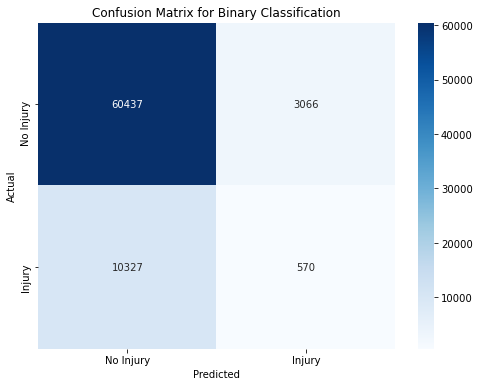

Ternary Classification Report:
              precision    recall  f1-score   support

           0       0.85      0.96      0.90     63503
           1       0.13      0.04      0.06      9399
           2       0.04      0.01      0.01      1498

    accuracy                           0.82     74400
   macro avg       0.34      0.33      0.33     74400
weighted avg       0.75      0.82      0.78     74400

Confusion Matrix (Ternary):
[[60664  2652   187]
 [ 8977   396    26]
 [ 1414    75     9]]


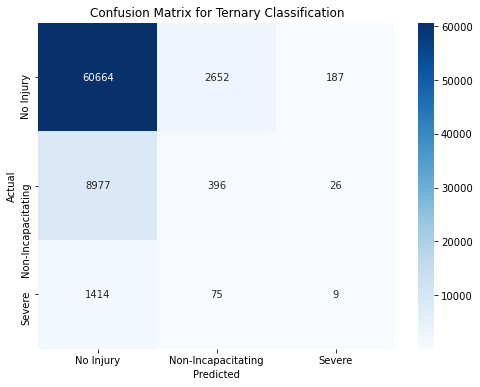

In [512]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.utils.class_weight import compute_class_weight
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.utils.class_weight import compute_class_weight
from imblearn.over_sampling import SMOTE
from xgboost import XGBClassifier
from sklearn.svm import SVC
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Convert crash_date and crash_time to datetime
data['crash_datetime'] = pd.to_datetime(data['crash_date'] + ' ' + data['crash_time'])
data['crash_day'] = data['crash_datetime'].dt.day
data['crash_month'] = data['crash_datetime'].dt.month
data['crash_year'] = data['crash_datetime'].dt.year
data['crash_hour'] = data['crash_datetime'].dt.hour
data.drop(columns=['crash_date', 'crash_time', 'crash_datetime'], inplace=True)

# Separate target variable
X = data.drop(columns=['most_severe_injury'])
y = data['most_severe_injury']

# Identify categorical and numerical columns
categorical_cols = X.select_dtypes(include=['int8']).columns
numerical_cols = X.select_dtypes(include=['int16', 'int64', 'float64']).columns

# Preprocessing for numerical data
numerical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='median')),
    ('scaler', StandardScaler())
])

# Preprocessing for categorical data
categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='most_frequent')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])

# Bundle preprocessing for numerical and categorical data
preprocessor = ColumnTransformer(
    transformers=[
        ('num', numerical_transformer, numerical_cols),
        ('cat', categorical_transformer, categorical_cols)
    ])

# Preprocessing pipeline
pipeline = Pipeline(steps=[('preprocessor', preprocessor)])

# Split data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Fit and transform the data using the pipeline
X_train_transformed = pipeline.fit_transform(X_train)
X_test_transformed = pipeline.transform(X_test)

# Binary classification target preparation
binary_target_map = {
    'no indication of injury': 0,
    'unknown': 0,
    'nonincapacitating injury': 1,
    'reported, not evident': 1,
    'incapacitating injury': 1,
    'fatal': 1
}
data['binary_target'] = data['most_severe_injury'].map(binary_target_map)

# Split the binary target data
y_train_binary = data.loc[y_train.index, 'binary_target']
y_test_binary = data.loc[y_test.index, 'binary_target']

# Compute class weights
class_weights_binary = compute_class_weight('balanced', classes=[0, 1], y=y_train_binary)
class_weights_binary_dict = {0: class_weights_binary[0], 1: class_weights_binary[1]}

# RandomForest for binary classification
rf_binary = RandomForestClassifier(class_weight=class_weights_binary_dict, random_state=42)
rf_binary.fit(X_train_transformed, y_train_binary)

# Predictions and evaluation for binary classification
y_pred_binary = rf_binary.predict(X_test_transformed)
print("Binary Classification Report:")
print(classification_report(y_test_binary, y_pred_binary))
print("Confusion Matrix (Binary):")
conf_matrix_binary = confusion_matrix(y_test_binary, y_pred_binary)
print(conf_matrix_binary)

# Plot confusion matrix for binary classification
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix_binary, annot=True, fmt='d', cmap='Blues', xticklabels=['No Injury', 'Injury'], yticklabels=['No Injury', 'Injury'])
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix for Binary Classification')
plt.show()

# Ternary classification target preparation
ternary_target_map = {
    'no indication of injury': 0,
    'unknown': 0,
    'nonincapacitating injury': 1,
    'reported, not evident': 1,
    'incapacitating injury': 2,
    'fatal': 2
}
data['ternary_target'] = data['most_severe_injury'].map(ternary_target_map)

# Split the ternary target data
y_train_ternary = data.loc[y_train.index, 'ternary_target']
y_test_ternary = data.loc[y_test.index, 'ternary_target']

# Compute class weights
class_weights_ternary = compute_class_weight('balanced', classes=[0, 1, 2], y=y_train_ternary)
class_weights_ternary_dict = {0: class_weights_ternary[0], 1: class_weights_ternary[1], 2: class_weights_ternary[2]}

# RandomForest for ternary classification
rf_ternary = RandomForestClassifier(class_weight=class_weights_ternary_dict, random_state=42)
rf_ternary.fit(X_train_transformed, y_train_ternary)

# Predictions and evaluation for ternary classification
y_pred_ternary = rf_ternary.predict(X_test_transformed)
print("Ternary Classification Report:")
print(classification_report(y_test_ternary, y_pred_ternary))
print("Confusion Matrix (Ternary):")
conf_matrix_ternary = confusion_matrix(y_test_ternary, y_pred_ternary)
print(conf_matrix_ternary)

# Plot confusion matrix for ternary classification
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix_ternary, annot=True, fmt='d', cmap='Blues', xticklabels=['No Injury', 'Non-Incapacitating', 'Severe'], yticklabels=['No Injury', 'Non-Incapacitating', 'Severe'])
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix for Ternary Classification')
plt.show()


**BINARY Classification**

False negatives (10,327) indicate missed injury predictions. Consider adjusting the model to reduce false negatives.
Investigate features related to injury severity (e.g.,  road conditions) to enhance recall.

False positives (3,066) represent incorrect injury predictions. Minimize these to avoid unnecessary alerts.
Review features contributing to false positives (e.g., weather conditions, traffic volume)

**TERNARY Classification**

The model performs well in predicting ‘Severe’ cases (high true positive rate).
However, it struggles with ‘Non-Incapacitating’ cases (high false positive rate).

They both had the same recall.I picked the binary classification as my baseline model and fit and test it with XGBoost model and SVM model considering class imbalance in play

Classification Report for RandomForestClassifier:
                          precision    recall  f1-score   support

                   fatal       0.00      0.00      0.00        85
   incapacitating injury       0.03      0.00      0.01      1413
 no indication of injury       0.85      0.96      0.90     63336
nonincapacitating injury       0.09      0.03      0.04      6239
   reported, not evident       0.04      0.01      0.02      3160
                 unknown       0.00      0.00      0.00       167

                accuracy                           0.82     74400
               macro avg       0.17      0.17      0.16     74400
            weighted avg       0.73      0.82      0.77     74400

Confusion Matrix for RandomForestClassifier:
[[    0     0    81     3     1     0]
 [    2     7  1342    46    16     0]
 [    3   216 60796  1599   709    13]
 [    1    18  5999   164    56     1]
 [    0     8  3045    73    34     0]
 [    0     0   164     2     1     0]]


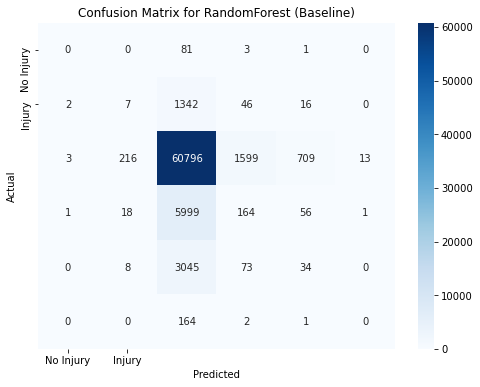

[13:11:34] WARNING: C:\Users\Administrator\workspace\xgboost-win64_release_1.2.0\src\learner.cc:516: 
Parameters: { use_label_encoder } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


Classification Report for XGBClassifier:
                          precision    recall  f1-score   support

                   fatal       0.00      0.00      0.00        85
   incapacitating injury       0.05      0.00      0.00      1413
 no indication of injury       0.85      0.99      0.92     63336
nonincapacitating injury       0.19      0.02      0.03      6239
   reported, not evident       0.05      0.00      0.00      3160
                 unknown       0.02      0.03      0.02       167

                accuracy                           0.84     74400
               macro avg       0.1

In [ ]:
from sklearn.metrics import precision_score, recall_score, f1_score, roc_auc_score
# Function to preprocess data
def preprocess_data(X_train, X_test):
    categorical_cols = X_train.select_dtypes(include=['int8']).columns
    numerical_cols = X_train.select_dtypes(include=['int16', 'int64', 'float64']).columns
    
    numerical_transformer = Pipeline(steps=[
        ('imputer', SimpleImputer(strategy='median')),
        ('scaler', StandardScaler())
    ])
    
    categorical_transformer = Pipeline(steps=[
        ('imputer', SimpleImputer(strategy='most_frequent')),
        ('onehot', OneHotEncoder(handle_unknown='ignore'))
    ])
    
    preprocessor = ColumnTransformer(
        transformers=[
            ('num', numerical_transformer, numerical_cols),
            ('cat', categorical_transformer, categorical_cols)
        ])
    
    pipeline = Pipeline(steps=[('preprocessor', preprocessor)])
    pipeline.fit(X_train)
    
    X_train_transformed = pipeline.transform(X_train)
    X_test_transformed = pipeline.transform(X_test)
    
    return X_train_transformed, X_test_transformed, pipeline

# Function to train and evaluate model
# Function to train and evaluate model
def train_and_evaluate_model(model, X_train, y_train, X_test, y_test):
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    y_pred_proba = model.predict_proba(X_test) if hasattr(model, "predict_proba") else None

    metrics = {}
    metrics['precision'] = precision_score(y_test, y_pred, average='weighted', zero_division=0)
    metrics['recall'] = recall_score(y_test, y_pred, average='weighted', zero_division=0)
    metrics['f1'] = f1_score(y_test, y_pred, average='weighted', zero_division=0)

    if y_pred_proba is not None:
        if len(np.unique(y_test)) == 2:  # Binary classification
            metrics['roc_auc'] = roc_auc_score(y_test, y_pred_proba[:, 1])
        else:  # Multiclass classification
            metrics['roc_auc'] = roc_auc_score(y_test, y_pred_proba, multi_class='ovr', average='weighted')

   
    
    
    print(f"Classification Report for {model.__class__.__name__}:")
    print(classification_report(y_test, y_pred))
    print(f"Confusion Matrix for {model.__class__.__name__}:")
    conf_matrix = confusion_matrix(y_test, y_pred)
    print(conf_matrix)
    
    return model, metrics, conf_matrix


# Preprocess data
X_train_transformed, X_test_transformed, pipeline = preprocess_data(X_train, X_test)

# Define and evaluate baseline model (RandomForest)
rf_binary = RandomForestClassifier(class_weight='balanced', random_state=42)
rf_binary, rf_metrics, rf_conf_matrix = train_and_evaluate_model(rf_binary, X_train_transformed, y_train, X_test_transformed, y_test)

# Plot confusion matrix for baseline model
plt.figure(figsize=(8, 6))
sns.heatmap(rf_conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=['No Injury', 'Injury'], yticklabels=['No Injury', 'Injury'])
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix for RandomForest (Baseline)')
plt.show()

# Apply SMOTE to balance the training data
smote = SMOTE(random_state=42)
X_train_smote, y_train_smote = smote.fit_resample(X_train_transformed, y_train)

# Define other models
xgb_model = XGBClassifier(use_label_encoder=False, eval_metric='logloss', random_state=42)
svm_model = SVC(class_weight='balanced', probability=True, random_state=42)

# Train and evaluate XGBoost model
xgb_model, xgb_metrics, xgb_conf_matrix = train_and_evaluate_model(xgb_model, X_train_smote, y_train_smote, X_test_transformed, y_test)

# Train and evaluate SVM model
svm_model, svm_metrics, svm_conf_matrix = train_and_evaluate_model(svm_model, X_train_smote, y_train_smote, X_test_transformed, y_test)

# Compare metrics
print("\nMetrics Comparison:")
print(f"RandomForest Metrics: {rf_metrics}")
print(f"XGBoost Metrics: {xgb_metrics}")
print(f"SVM Metrics: {svm_metrics}")

# Plot confusion matrices for other models
plt.figure(figsize=(8, 6))
sns.heatmap(xgb_conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=['No Injury', 'Injury'], yticklabels=['No Injury', 'Injury'])
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix for XGBoost')
plt.show()

plt.figure(figsize=(8, 6))
sns.heatmap(svm_conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=['No Injury', 'Injury'], yticklabels=['No Injury', 'Injury'])
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix for SVM')
plt.show()

In [ ]:
from sklearn.model_selection import GridSearchCV

# Define the parameter grid for XGBoost
param_grid = {
    'n_estimators': [100, 200, 300],
    'learning_rate': [0.01, 0.1, 0.2],
    'max_depth': [3, 5, 7],
    'subsample': [0.8, 1.0],
    'colsample_bytree': [0.8, 1.0]
}

# Initialize the XGBoost model
xgb_model = XGBClassifier(use_label_encoder=False, eval_metric='logloss', random_state=42)

# Set up GridSearchCV
grid_search = GridSearchCV(estimator=xgb_model, param_grid=param_grid, 
                           scoring='roc_auc', cv=3, n_jobs=-1, verbose=2)

# Fit GridSearchCV
grid_search.fit(X_train_smote, y_train_smote)

# Get the best model and its parameters
best_xgb_model = grid_search.best_estimator_
print(f"Best parameters found: {grid_search.best_params_}")

# Evaluate the best model
best_xgb_model, xgb_metrics, xgb_conf_matrix = train_and_evaluate_model(best_xgb_model, X_train_smote, y_train_smote, X_test_transformed, y_test)

# Print the best metrics
print("\nBest XGBoost Metrics:")
print(xgb_metrics)

# Plot confusion matrix for the best XGBoost model
plt.figure(figsize=(8, 6))
sns.heatmap(xgb_conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=['No Injury', 'Injury'], yticklabels=['No Injury', 'Injury'])
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix for Best XGBoost')
plt.show()


# Classification Report and Confusion Matrix Analysis for XGBClassifier

## Classification Report
The classification report provides a detailed breakdown of the model's performance for each class. The metrics include precision, recall, and f1-score.

| Severity Category            | Precision | Recall | F1-Score | Support |
|------------------------------|-----------|--------|----------|---------|
| Fatal                        | 0.00      | 0.00   | 0.00     | 85      |
| Incapacitating Injury        | 0.05      | 0.00   | 0.00     | 1413    |
| No Indication of Injury      | 0.85      | 0.99   | 0.92     | 63336   |
| Nonincapacitating Injury     | 0.19      | 0.02   | 0.03     | 6239    |
| Reported, Not Evident        | 0.05      | 0.00   | 0.00     | 3160    |
| Unknown                      | 0.02      | 0.03   | 0.02     | 167     |

**Overall Metrics:**
- **Accuracy:** 0.84
- **Macro Avg Precision:** 0.19
- **Macro Avg Recall:** 0.17
- **Macro Avg F1-Score:** 0.16
- **Weighted Avg Precision:** 0.75
- **Weighted Avg Recall:** 0.84
- **Weighted Avg F1-Score:** 0.78

## Confusion Matrix
The confusion matrix helps visualize the performance of the model by showing the actual vs. predicted classifications.

|                | Fatal | Incapacitating Injury | No Indication of Injury | Nonincapacitating Injury | Reported, Not Evident | Unknown |
|----------------|-------|-----------------------|-------------------------|--------------------------|------------------------|---------|
| **Fatal**      | 0     | 0                     | 78                      | 2                        | 0                      | 5       |
| **Incapacitating Injury** | 1 | 3 | 1371 | 30 | 2 | 6 |
| **No Indication of Injury** | 56 | 47 | 62587 | 397 | 54 | 195 |
| **Nonincapacitating Injury** | 6 | 8 | 6073 | 113 | 5 | 34 |
| **Reported, Not Evident** | 7 | 4 | 3096 | 42 | 3 | 8 |
| **Unknown** | 0 | 0 | 159 | 3 | 0 | 5 |

## Interpretation and Analysis

1. **Class Imbalance:** The dataset is heavily imbalanced, with the majority of the data belonging to the "No Indication of Injury" class. This is reflected in the high precision, recall, and F1-score for this class, but poor performance for the others.

2. **Poor Performance in Minority Classes:** 
    - The model performs poorly in predicting "Fatal," "Incapacitating Injury," "Nonincapacitating Injury," "Reported, Not Evident," and "Unknown" categories. This is indicated by the low precision, recall, and F1-scores.
    - The confusion matrix shows that most minority class instances are misclassified as "No Indication of Injury."

3. **Misclassified Data Analysis:**
    - Many "Fatal" cases are misclassified as "No Indication of Injury."
    - A significant number of "Incapacitating Injury," "Nonincapacitating Injury," and "Reported, Not Evident" cases are also misclassified as "No Indication of Injury."
    - This suggests that the model struggles to differentiate between the severity levels, especially for the more severe injury categories.

# RECOMMENDATIONS AND FUTURE WORK

## Recommendations

1. **Address Class Imbalance:**
    - **Resampling Techniques:** Implement oversampling for minority classes (e.g., SMOTE) or undersampling for the majority class.
    - **Class Weighting:** Adjust the class weights in the model to give more importance to the minority classes.

2. **Feature Engineering:**
    - **Additional Features:** Investigate and incorporate more relevant features that could help distinguish between different injury severities (e.g., vehicle speed, collision type, weather conditions).
    - **Interaction Features:** Explore interactions between existing features to capture more complex relationships.

3. **Model Tuning:**
    - **Hyperparameter Optimization:** Perform a more extensive grid search or use techniques like randomized search or Bayesian optimization for hyperparameter tuning.
    - **Ensemble Methods:** Consider using ensemble techniques to combine predictions from multiple models, which can improve the robustness and performance of the predictions.

4. **Evaluation Metrics:**
    - **Custom Metrics:** Use evaluation metrics that are more sensitive to class imbalance, such as the balanced accuracy score, F2 score, or Matthews correlation coefficient.

5. **Data Augmentation:**
    - Explore techniques to augment the dataset with synthetic data, especially for underrepresented classes, to help the model learn better.

## Conclusion
The current XGBClassifier model shows high accuracy and performance for the majority class but struggles significantly with minority classes due to severe class imbalance. By addressing these imbalances, incorporating additional and more relevant features, and optimizing the model further, we can aim to improve the overall predictive performance and ensure better handling of all severity classes.
